In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os
import sys
from PIL import Image
import matplotlib.cm as cm
from sklearn.model_selection import train_test_split

sys.path.append(os.path.abspath(".."))


In [2]:
label = 0
X, y = [], []
path = "final_dataset/yaleB"
for dirname, dirnames, filenames in os.walk(path):
    for subdirname in dirnames:
        subject_path = os.path.join(dirname, subdirname)
        y.append(np.repeat(label, len(os.listdir(subject_path))))
        for filename in os.listdir(subject_path):
            image_path = os.path.join(subject_path, filename)
            im = Image.open(image_path)
            im = im.convert("L")
            X.append(np.asarray(im, dtype=np.uint8))
        label = label + 1
y = list(np.concatenate(y))


In [3]:
def fisherfaces(X, y):
    y = np.asarray(y)
    mean_face = X.mean()
    Xmean_face = X - mean_face
    C = Xmean_face @ Xmean_face.T
    [pcavals, pcavects] = np.linalg.eigh(C)
    pcavects = Xmean_face.T @ pcavects
    for i in range(X.shape[0]):
        pcavects[:, i] = pcavects[:, i] / np.linalg.norm(pcavects[:, i])

    projections = X @ pcavects
    meanTotal = projections.mean(axis=0)
    Sw = np.zeros((projections.shape[1], projections.shape[1]), dtype=np.float32)
    Sb = np.zeros((projections.shape[1], projections.shape[1]), dtype=np.float32)
    c = np.unique(y)

    for i in c:
        xi = projections[np.where(y == i)[0], :]
        meanClass = xi.mean(axis=0)
        Cov_mean_class = (xi - meanClass).T @ (xi - meanClass)
        Sw = Sw + Cov_mean_class
        Cov_mean = (meanClass - meanTotal).T @ (meanClass - meanTotal)
        Sb = Sb + Cov_mean
    mat = np.linalg.inv(Sw) * Sb
    ldavects = np.linalg.eig(mat)[1]
    ldavects = np.array(ldavects[0:, 0:].real)

    eigenvectors = np.dot(pcavects, ldavects)
    return [eigenvectors, mean_face]


In [4]:
class FisherfacesModel(object):
    def __init__(self, X, y):
        self.projections = []
        self.eig_vecs = []
        self.mean_face = []
        self.train(X, y)

    def train(self, X, y):
        matX = np.empty((0, X[0].size))
        for row in X:
            matX = np.vstack((matX, np.asarray(row).reshape(1, -1)))
        [self.eig_vecs, self.mean_face] = fisherfaces(matX, y)
        self.y = y
        for xi in X:
            self.projections.append(
                (xi.reshape(1, -1) - self.mean_face) @ self.eig_vecs
            )

    def test(self, X):
        dists = []
        Q = (X.reshape(1, -1) - self.mean_face) @ self.eig_vecs
        for i in range(len(self.projections)):
            dist = np.linalg.norm(
                np.asarray(self.projections[i]).flatten() - np.asarray(Q).flatten()
            )
            dists.append(dist)
        return self.y[np.argmin(dists)]


In [5]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
model = FisherfacesModel(X_train, y_train)


In [6]:
def plot_guesses(X_test, X_pred):
    fig = plt.figure(figsize=(5, 5))
    fig.add_subplot(1, 2, 1)
    plt.imshow(X_test, cmap=cm.gray)
    plt.axis("off")

    fig.add_subplot(1, 2, 2)
    plt.imshow(X_pred, cmap=cm.gray)
    plt.axis("off")
    plt.show()

    print("\n")


In [7]:
predicted = []
correct = []
for i in range(len(y_test)):
    prediction = model.test(X_test[i])
    predicted.append(prediction)
    correct.append(0)

    if prediction == y_test[i]:
        correct[i] = 1

accuracy = (np.sum(correct) / len(y_test)) * 100

print("Accuracy: ", accuracy, "%")


Accuracy:  75.56935817805382 %


# Print Correct Guesses

Expected = 37        Predicted = 37


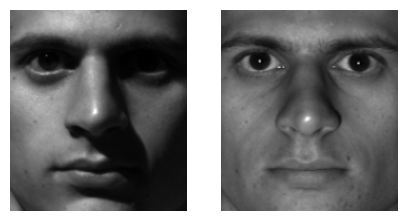



Expected = 10        Predicted = 10


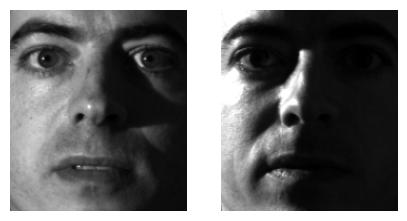



Expected = 25        Predicted = 25


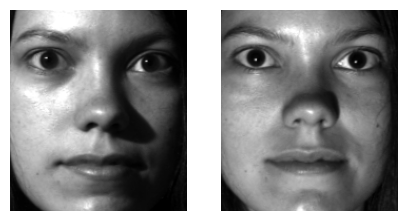



Expected = 12        Predicted = 12


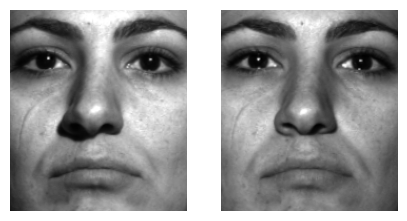



Expected = 35        Predicted = 35


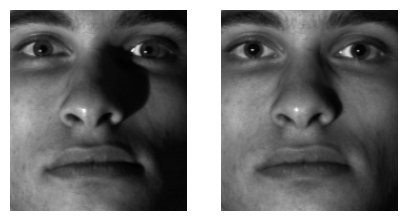



Expected = 6        Predicted = 6


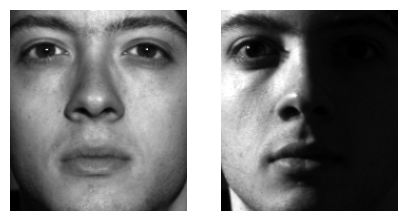



Expected = 30        Predicted = 30


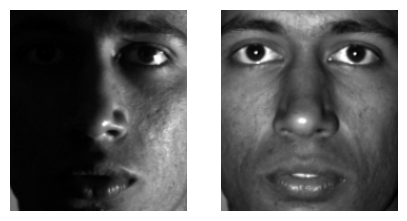



Expected = 30        Predicted = 30


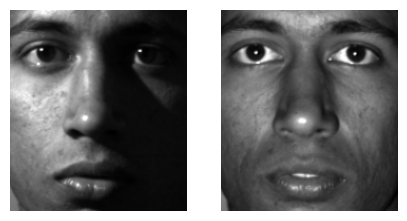



Expected = 9        Predicted = 9


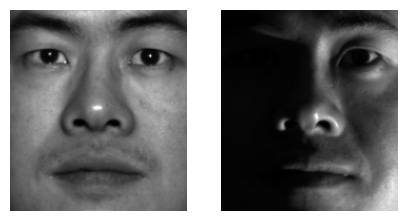



Expected = 1        Predicted = 1


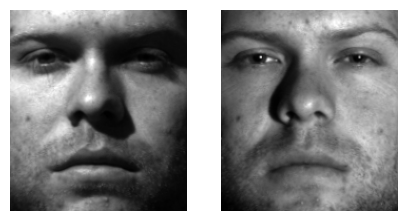



Expected = 17        Predicted = 17


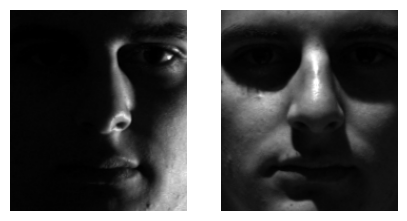



Expected = 34        Predicted = 34


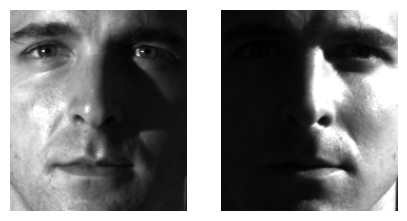



Expected = 33        Predicted = 33


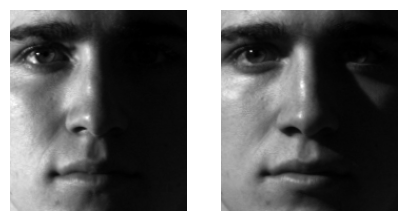



Expected = 9        Predicted = 9


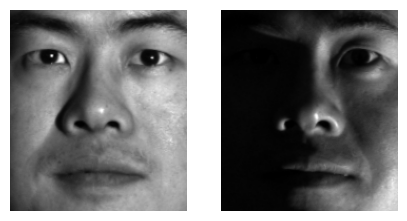



Expected = 3        Predicted = 3


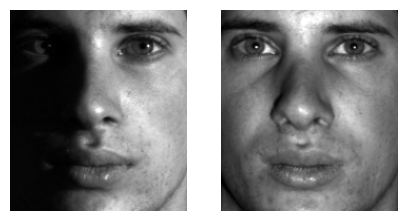



Expected = 19        Predicted = 19


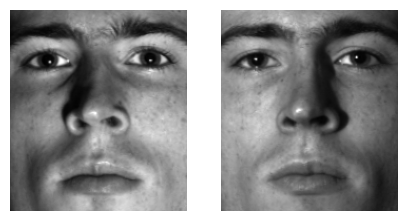



Expected = 28        Predicted = 28


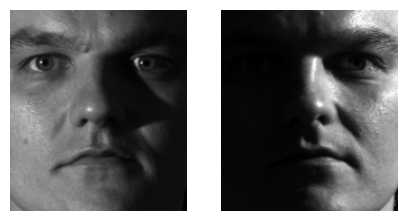



Expected = 13        Predicted = 13


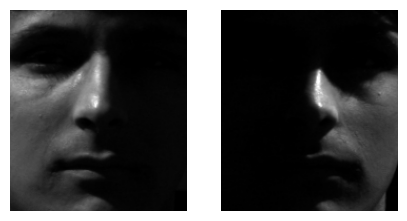



Expected = 14        Predicted = 14


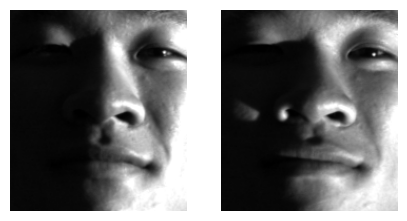



Expected = 16        Predicted = 16


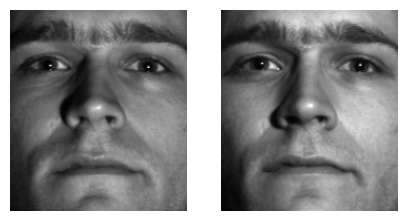



Expected = 31        Predicted = 31


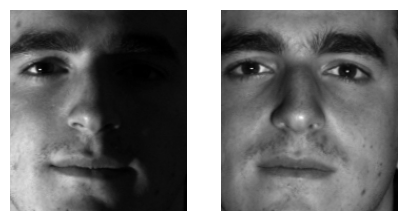



Expected = 24        Predicted = 24


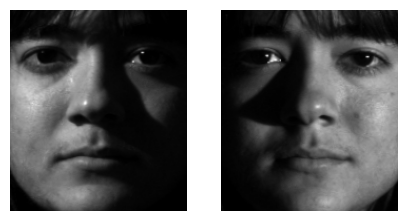



Expected = 0        Predicted = 0


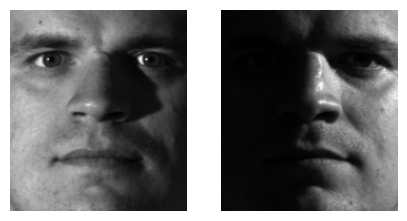



Expected = 2        Predicted = 2


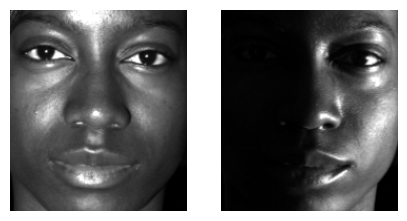



Expected = 23        Predicted = 23


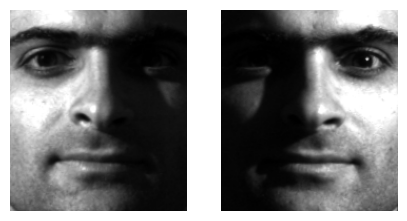



Expected = 15        Predicted = 15


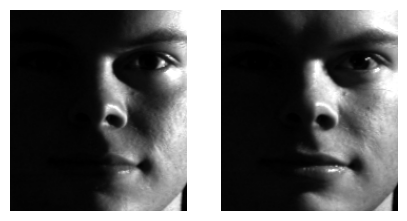



Expected = 24        Predicted = 24


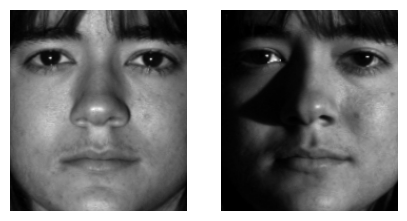



Expected = 19        Predicted = 19


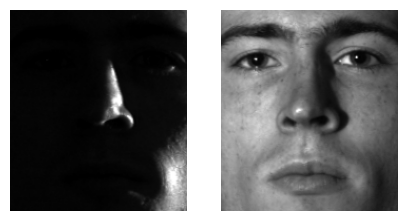



Expected = 27        Predicted = 27


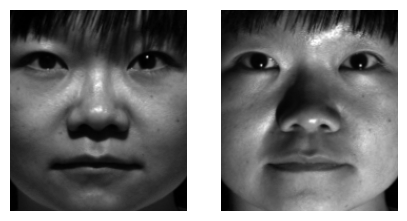



Expected = 29        Predicted = 29


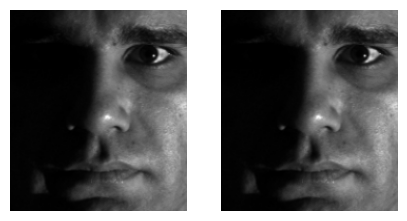



Expected = 11        Predicted = 11


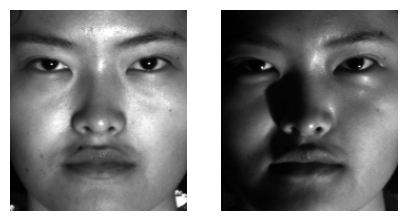



Expected = 2        Predicted = 2


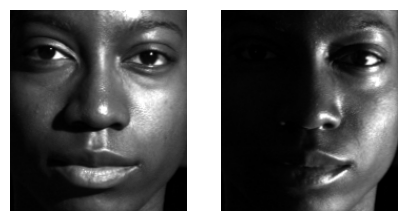



Expected = 8        Predicted = 8


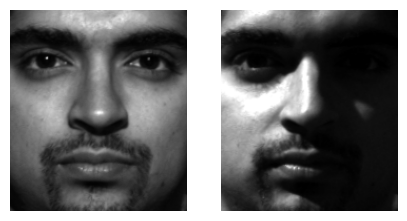



Expected = 27        Predicted = 27


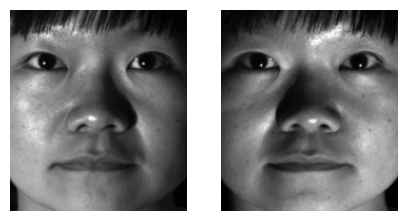



Expected = 3        Predicted = 3


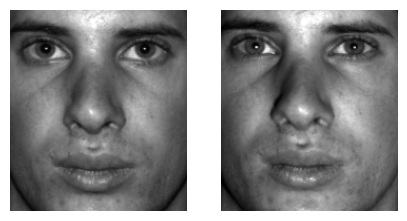



Expected = 11        Predicted = 11


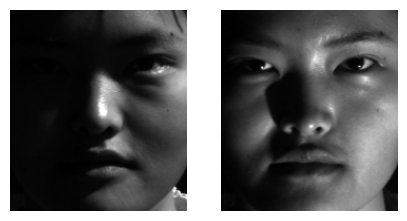



Expected = 37        Predicted = 37


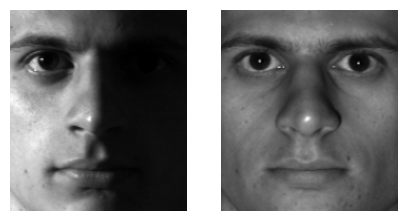



Expected = 2        Predicted = 2


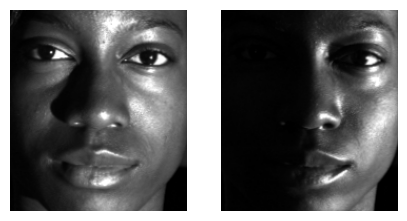



Expected = 7        Predicted = 7


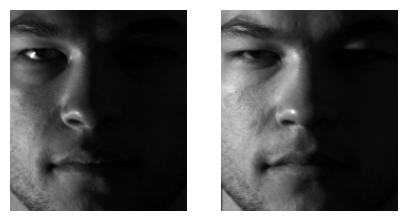



Expected = 28        Predicted = 28


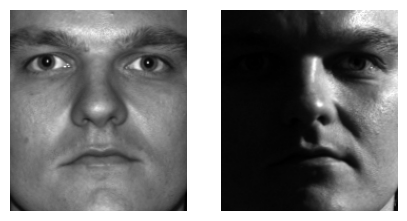



Expected = 14        Predicted = 14


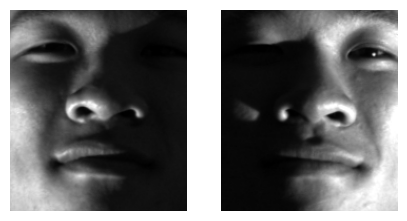



Expected = 18        Predicted = 18


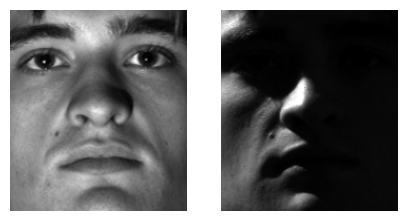



Expected = 13        Predicted = 13


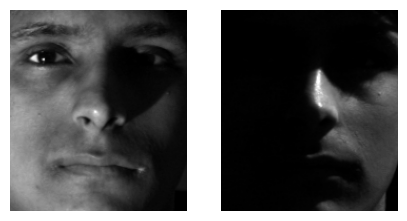



Expected = 8        Predicted = 8


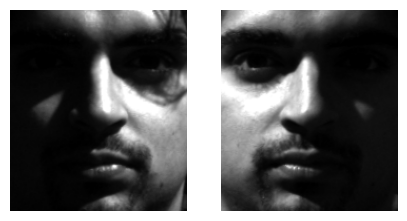



Expected = 7        Predicted = 7


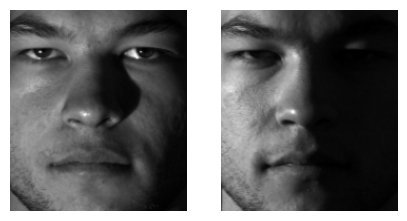



Expected = 12        Predicted = 12


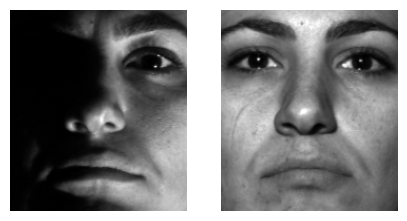



Expected = 5        Predicted = 5


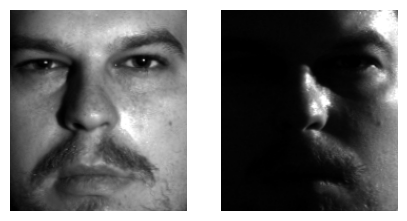



Expected = 3        Predicted = 3


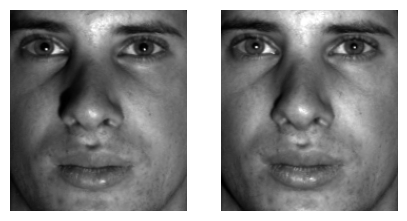



Expected = 37        Predicted = 37


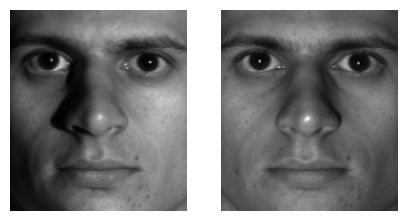



Expected = 26        Predicted = 26


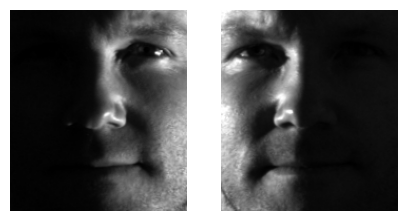



Expected = 2        Predicted = 2


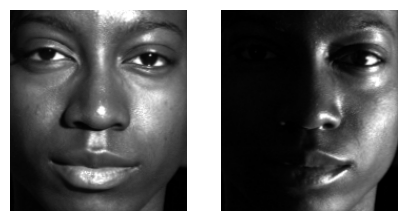



Expected = 25        Predicted = 25


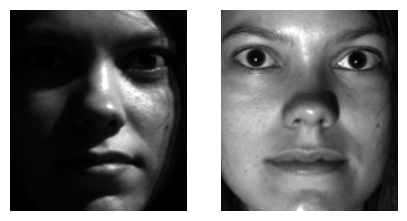



Expected = 21        Predicted = 21


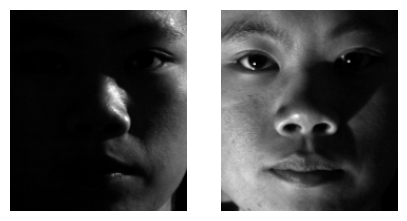



Expected = 23        Predicted = 23


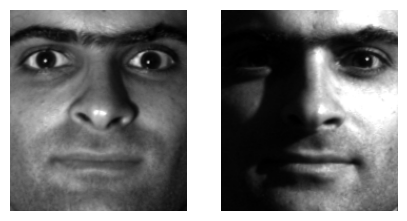



Expected = 30        Predicted = 30


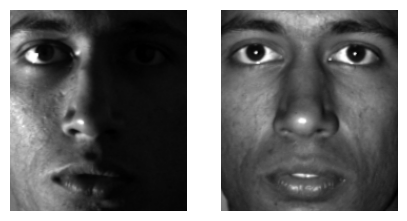



Expected = 6        Predicted = 6


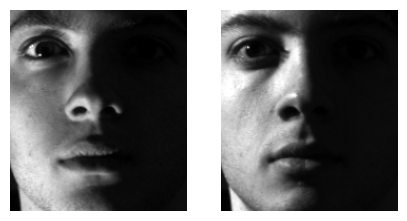



Expected = 3        Predicted = 3


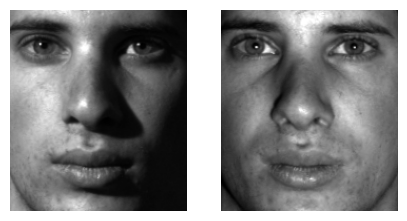



Expected = 32        Predicted = 32


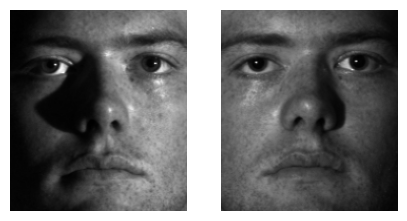



Expected = 11        Predicted = 11


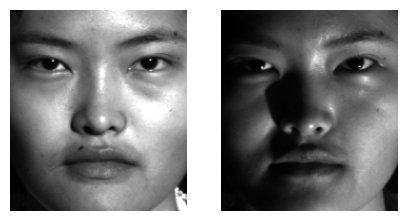



Expected = 11        Predicted = 11


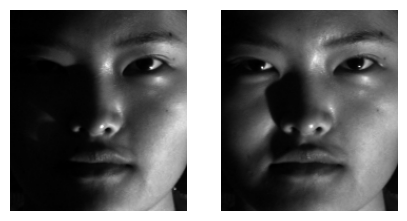



Expected = 14        Predicted = 14


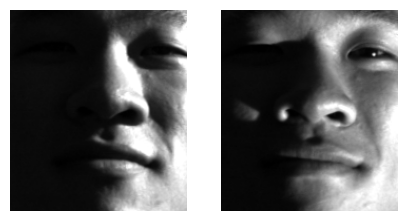



Expected = 17        Predicted = 17


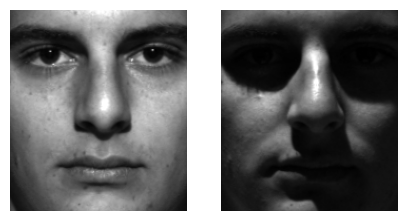



Expected = 11        Predicted = 11


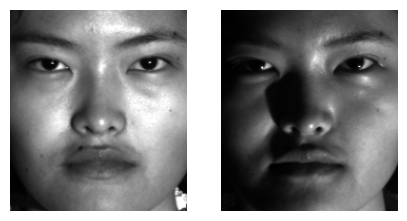



Expected = 3        Predicted = 3


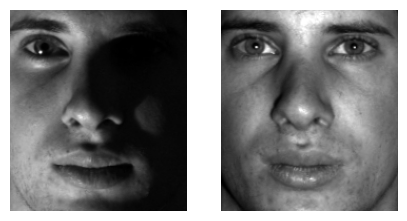



Expected = 16        Predicted = 16


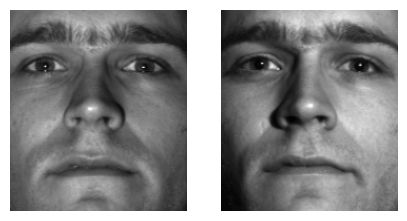



Expected = 13        Predicted = 13


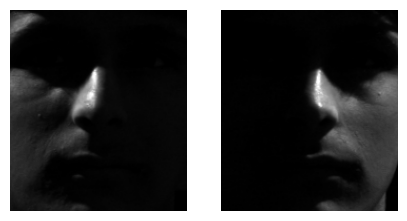



Expected = 12        Predicted = 12


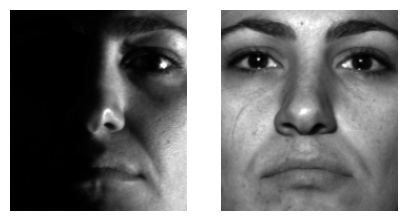



Expected = 19        Predicted = 19


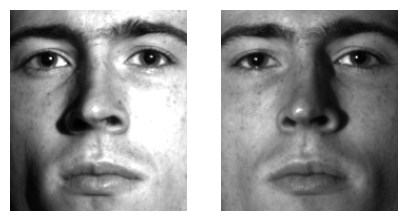



Expected = 4        Predicted = 4


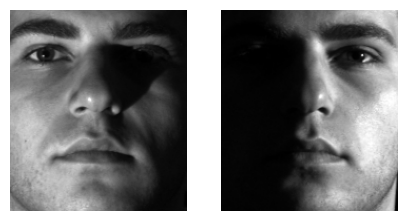



Expected = 13        Predicted = 13


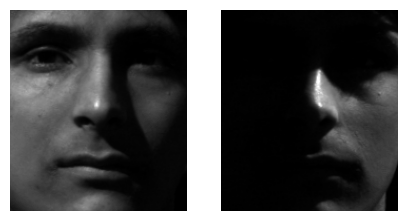



Expected = 7        Predicted = 7


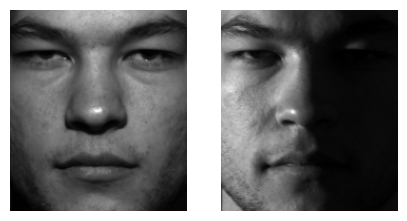



Expected = 5        Predicted = 5


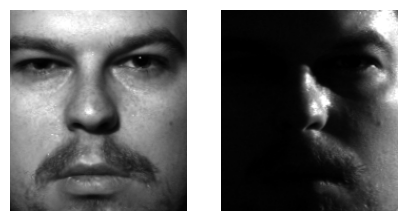



Expected = 27        Predicted = 27


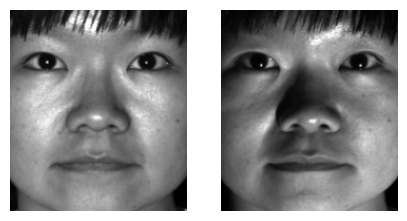



Expected = 34        Predicted = 34


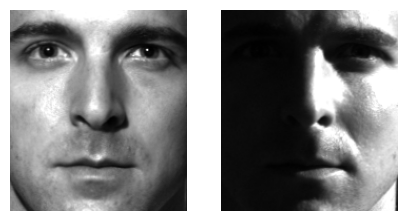



Expected = 17        Predicted = 17


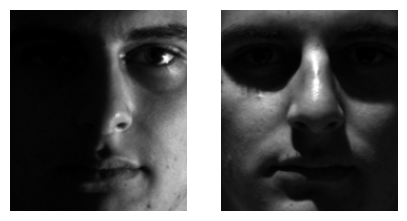



Expected = 21        Predicted = 21


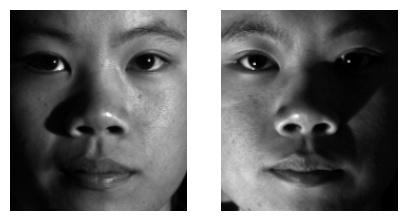



Expected = 15        Predicted = 15


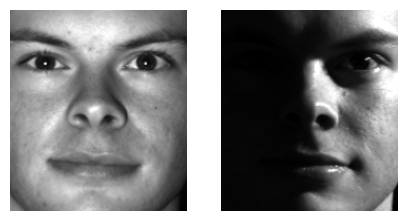



Expected = 4        Predicted = 4


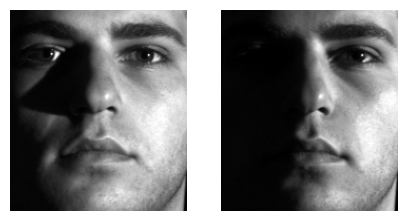



Expected = 5        Predicted = 5


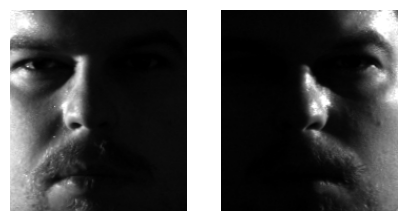



Expected = 10        Predicted = 10


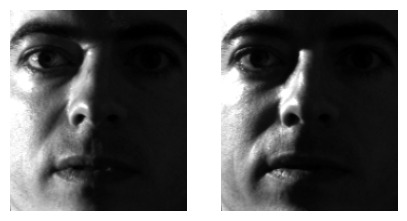



Expected = 24        Predicted = 24


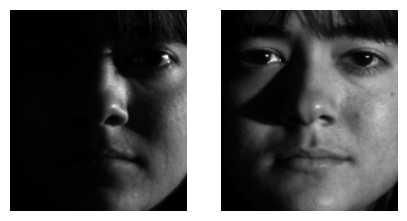



Expected = 36        Predicted = 36


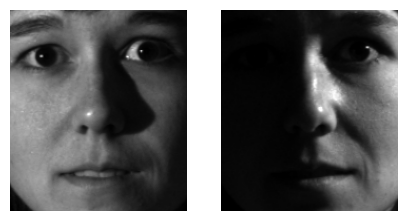



Expected = 13        Predicted = 13


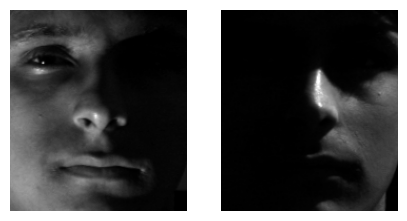



Expected = 30        Predicted = 30


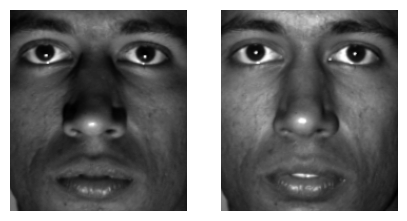



Expected = 12        Predicted = 12


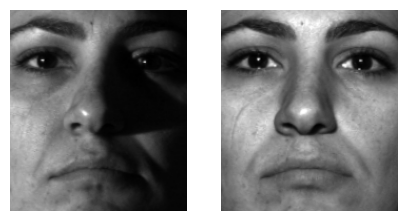



Expected = 8        Predicted = 8


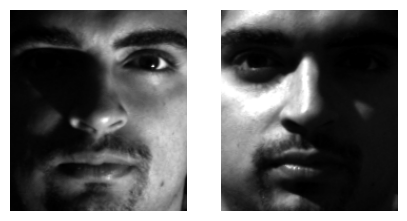



Expected = 36        Predicted = 36


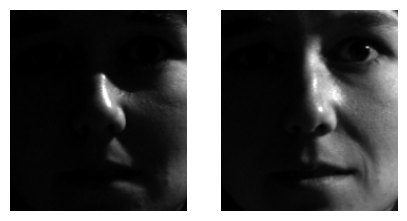



Expected = 4        Predicted = 4


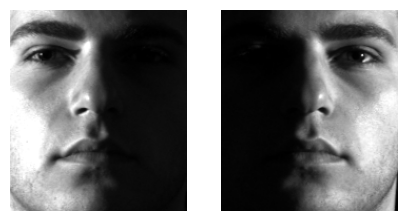



Expected = 5        Predicted = 5


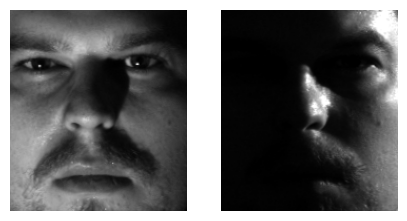



Expected = 27        Predicted = 27


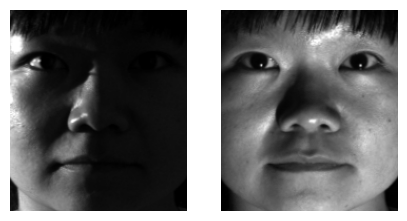



Expected = 24        Predicted = 24


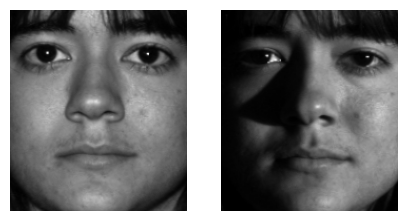



Expected = 12        Predicted = 12


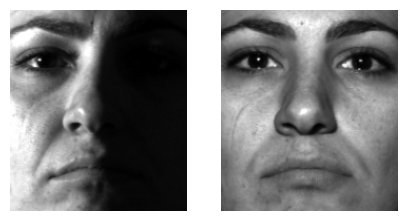



Expected = 12        Predicted = 12


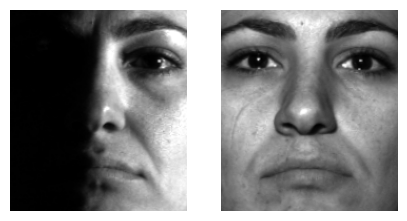



Expected = 16        Predicted = 16


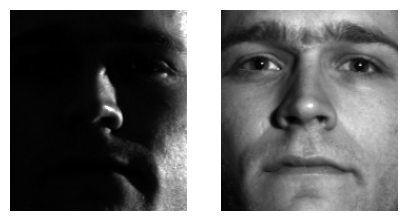



Expected = 13        Predicted = 13


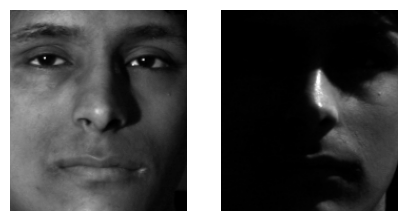



Expected = 14        Predicted = 14


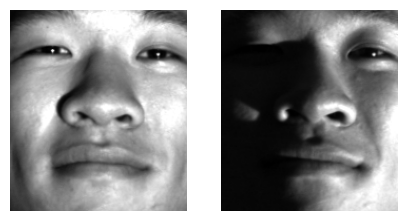



Expected = 33        Predicted = 33


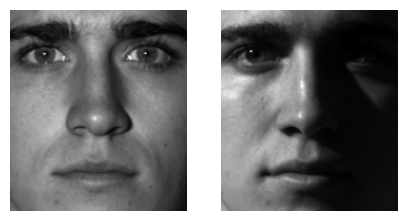



Expected = 31        Predicted = 31


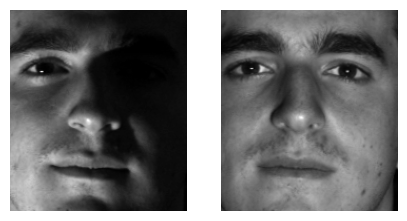



Expected = 11        Predicted = 11


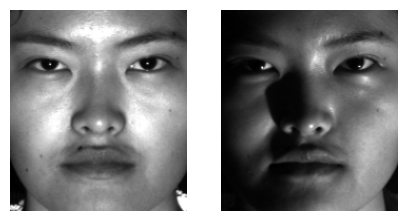



Expected = 4        Predicted = 4


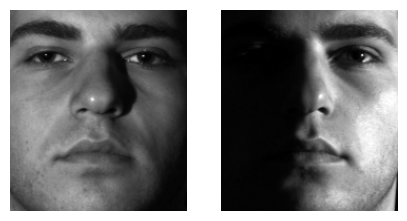



Expected = 29        Predicted = 29


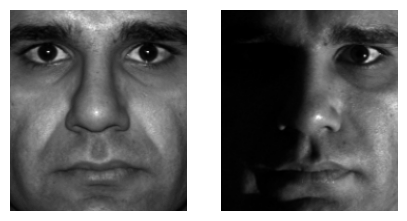



Expected = 18        Predicted = 18


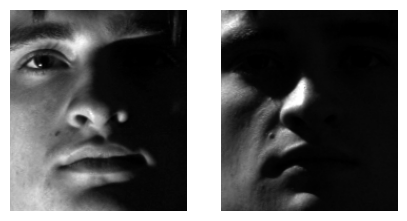



Expected = 22        Predicted = 22


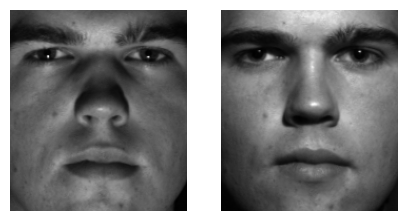



Expected = 37        Predicted = 37


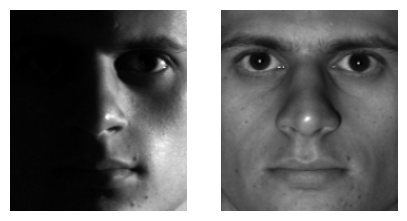



Expected = 4        Predicted = 4


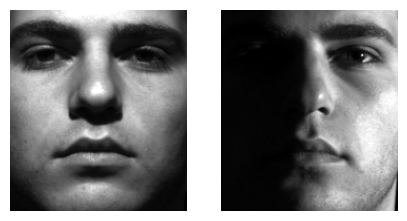



Expected = 35        Predicted = 35


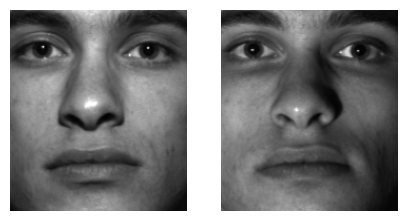



Expected = 10        Predicted = 10


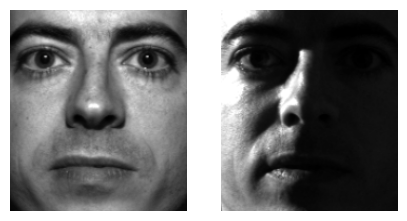



Expected = 3        Predicted = 3


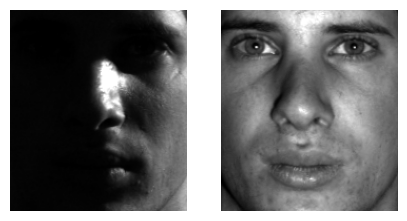



Expected = 23        Predicted = 23


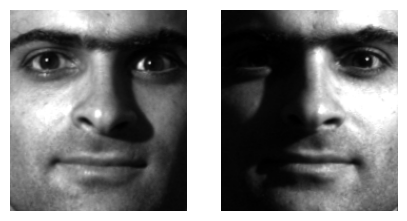



Expected = 8        Predicted = 8


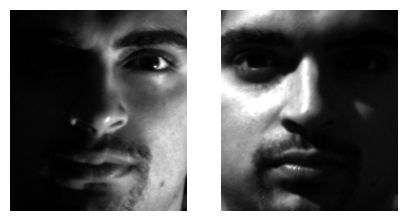



Expected = 15        Predicted = 15


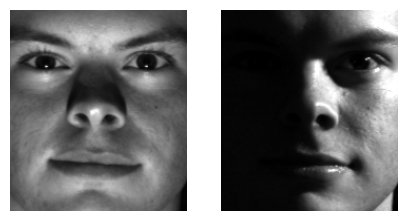



Expected = 16        Predicted = 16


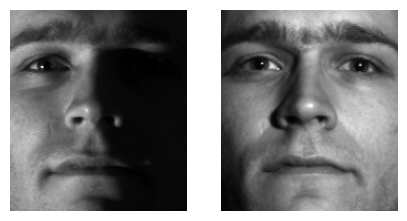



Expected = 35        Predicted = 35


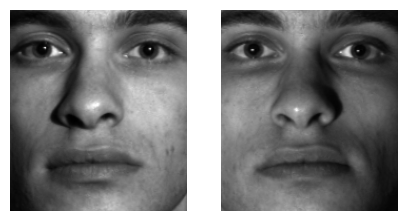



Expected = 17        Predicted = 17


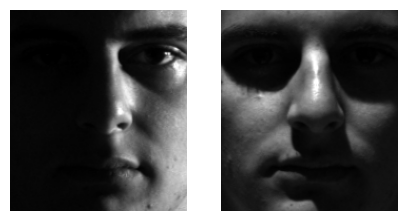



Expected = 13        Predicted = 13


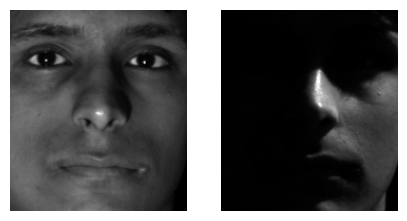



Expected = 11        Predicted = 11


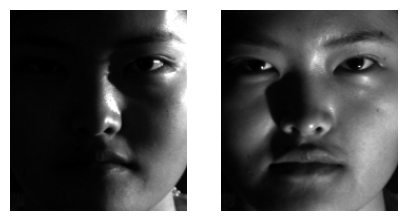



Expected = 2        Predicted = 2


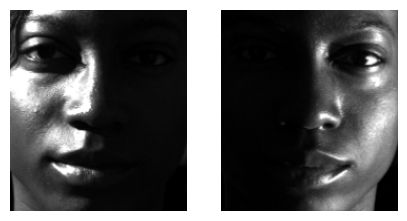



Expected = 14        Predicted = 14


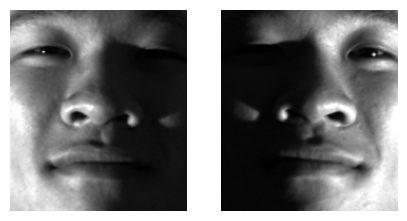



Expected = 23        Predicted = 23


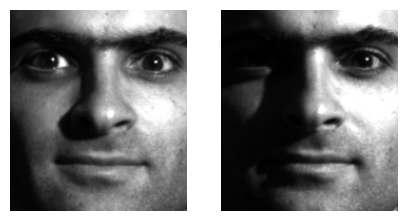



Expected = 3        Predicted = 3


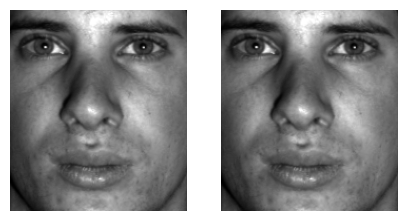



Expected = 20        Predicted = 20


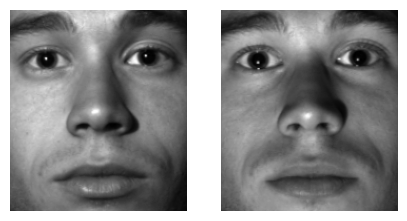



Expected = 32        Predicted = 32


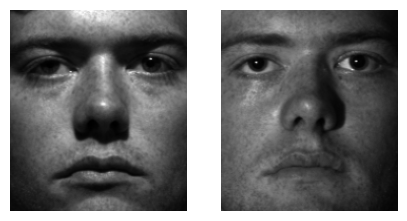



Expected = 34        Predicted = 34


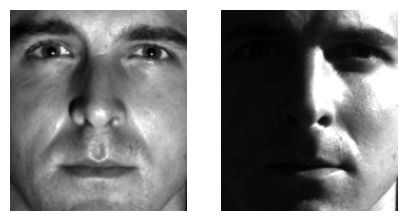



Expected = 36        Predicted = 36


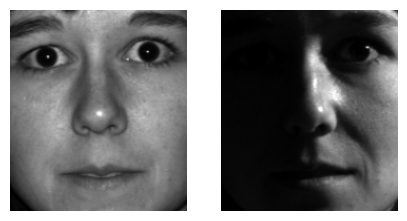



Expected = 23        Predicted = 23


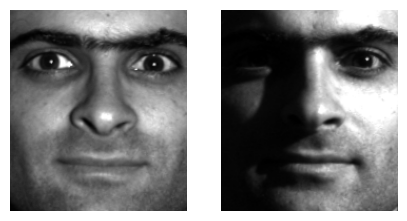



Expected = 31        Predicted = 31


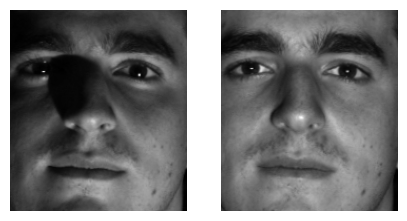



Expected = 6        Predicted = 6


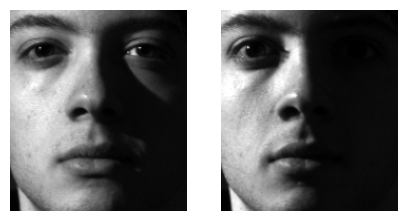



Expected = 11        Predicted = 11


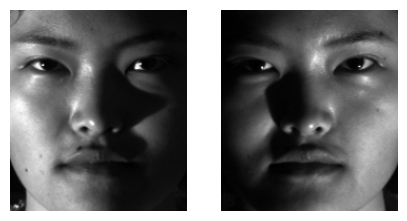



Expected = 29        Predicted = 29


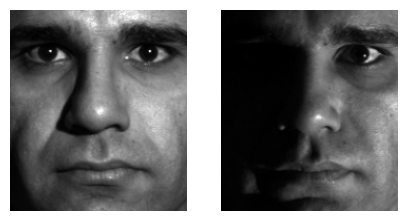



Expected = 14        Predicted = 14


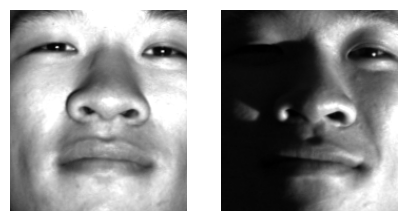



Expected = 18        Predicted = 18


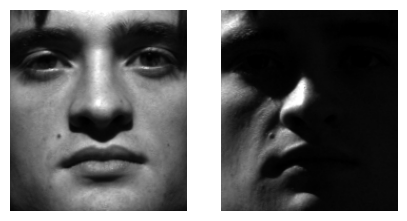



Expected = 26        Predicted = 26


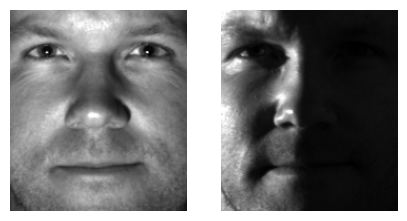



Expected = 25        Predicted = 25


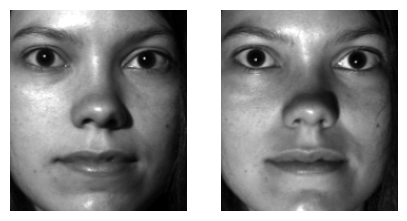



Expected = 24        Predicted = 24


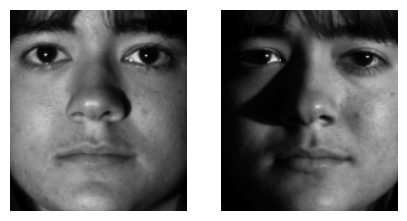



Expected = 23        Predicted = 23


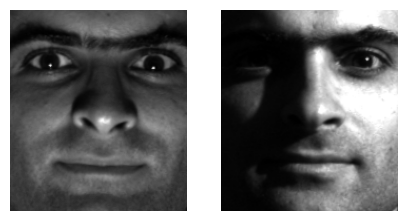



Expected = 28        Predicted = 28


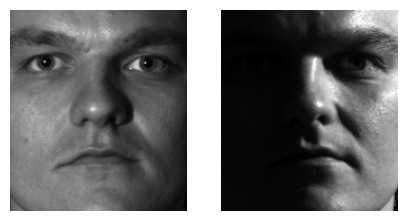



Expected = 17        Predicted = 17


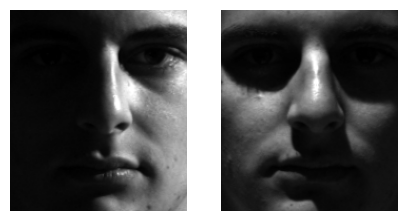



Expected = 26        Predicted = 26


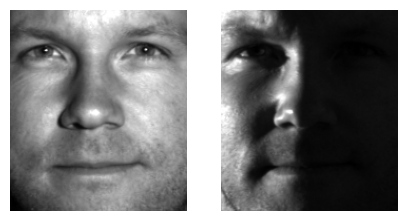



Expected = 14        Predicted = 14


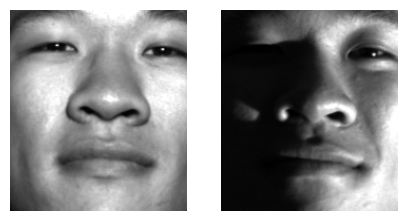



Expected = 31        Predicted = 31


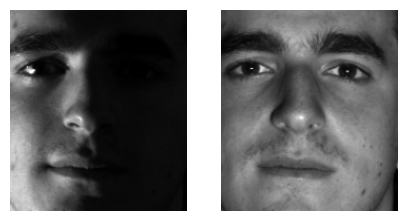



Expected = 23        Predicted = 23


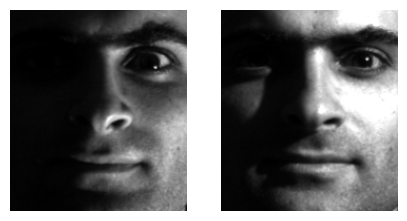



Expected = 14        Predicted = 14


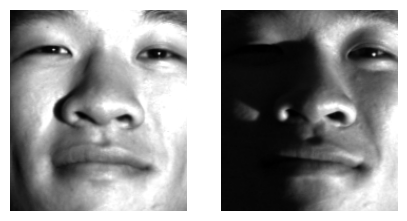



Expected = 19        Predicted = 19


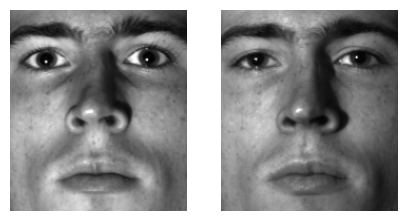



Expected = 25        Predicted = 25


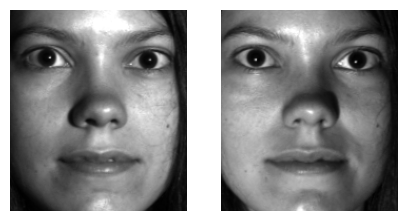



Expected = 21        Predicted = 21


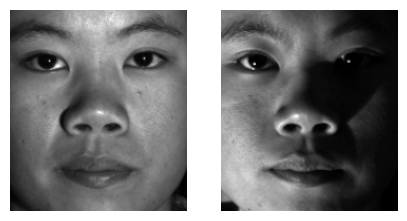



Expected = 28        Predicted = 28


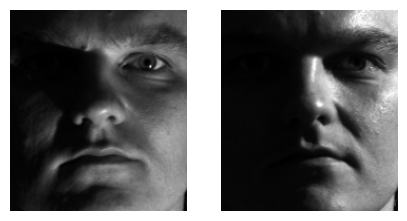



Expected = 5        Predicted = 5


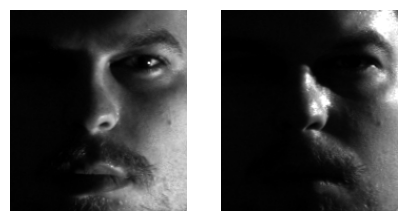



Expected = 20        Predicted = 20


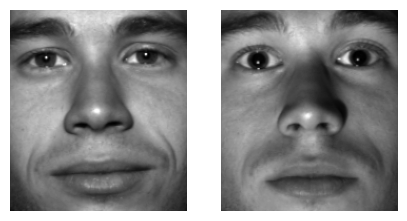



Expected = 26        Predicted = 26


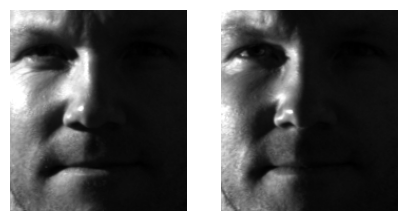



Expected = 19        Predicted = 19


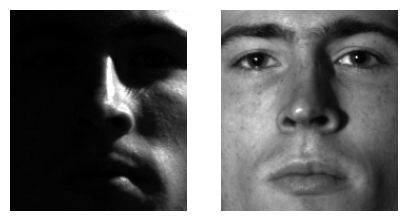



Expected = 27        Predicted = 27


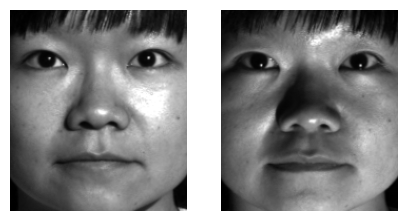



Expected = 21        Predicted = 21


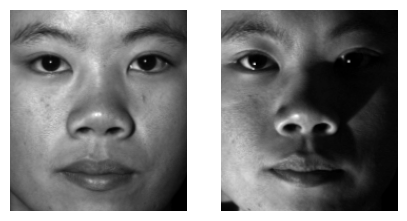



Expected = 19        Predicted = 19


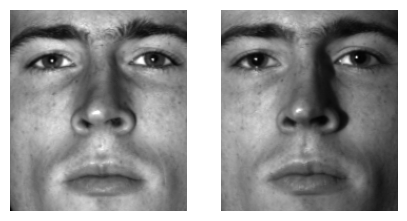



Expected = 9        Predicted = 9


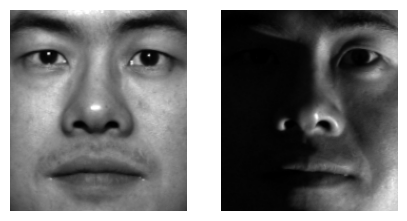



Expected = 23        Predicted = 23


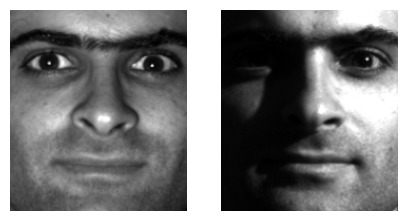



Expected = 26        Predicted = 26


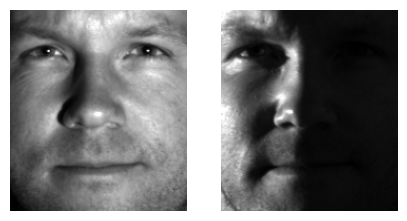



Expected = 34        Predicted = 34


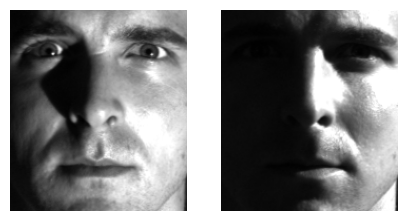



Expected = 20        Predicted = 20


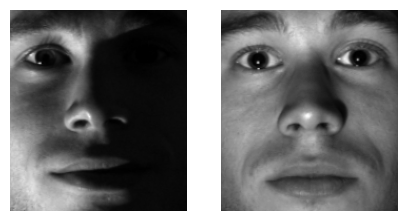



Expected = 28        Predicted = 28


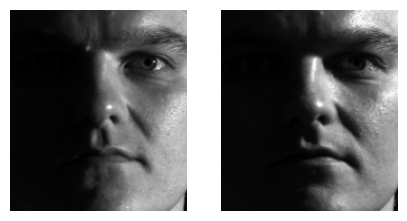



Expected = 1        Predicted = 1


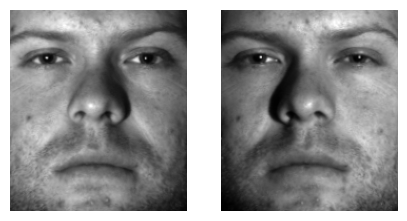



Expected = 37        Predicted = 37


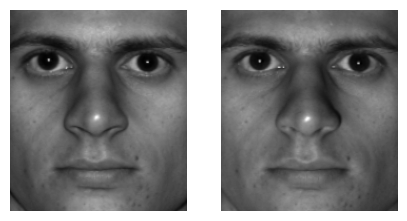



Expected = 14        Predicted = 14


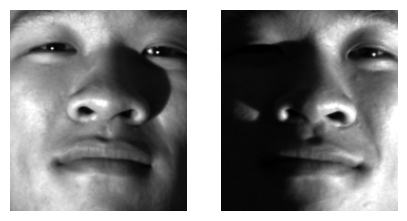



Expected = 35        Predicted = 35


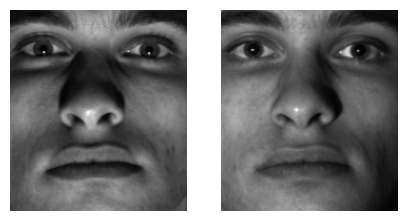



Expected = 13        Predicted = 13


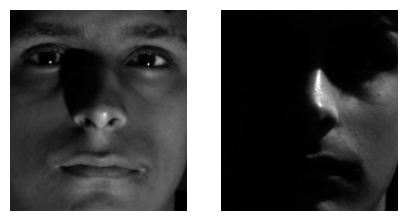



Expected = 10        Predicted = 10


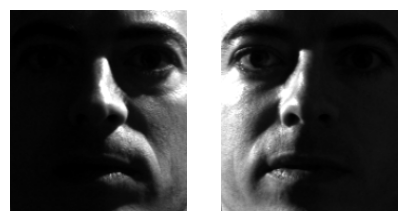



Expected = 15        Predicted = 15


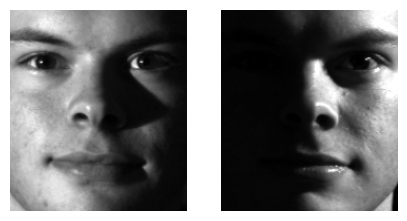



Expected = 11        Predicted = 11


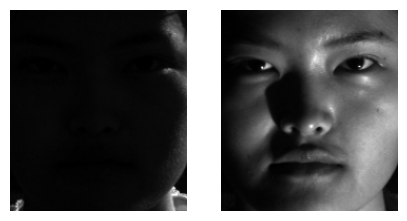



Expected = 34        Predicted = 34


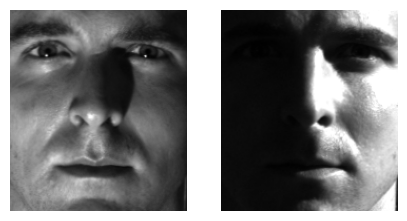



Expected = 8        Predicted = 8


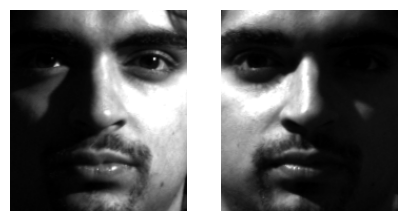



Expected = 14        Predicted = 14


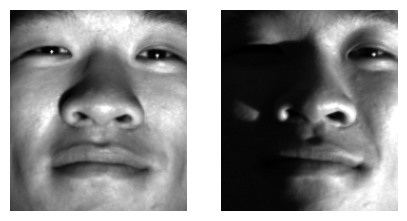



Expected = 19        Predicted = 19


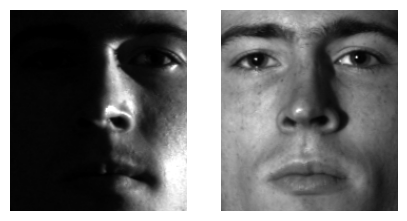



Expected = 37        Predicted = 37


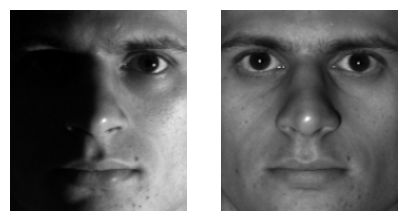



Expected = 27        Predicted = 27


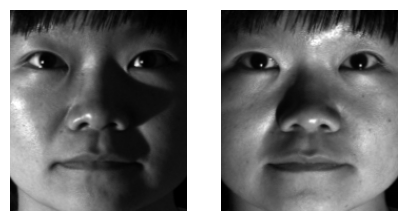



Expected = 8        Predicted = 8


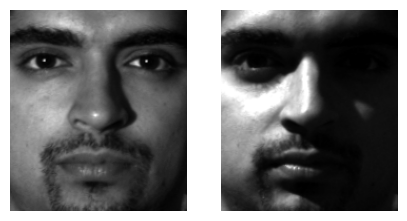



Expected = 27        Predicted = 27


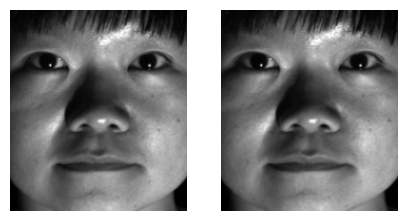



Expected = 16        Predicted = 16


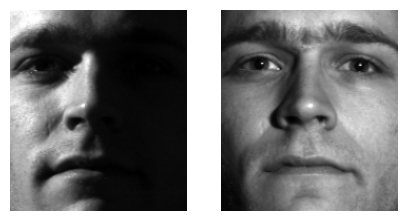



Expected = 29        Predicted = 29


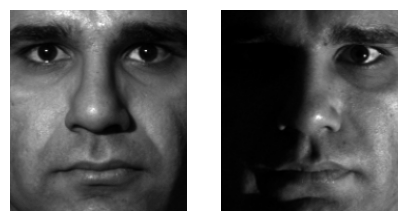



Expected = 36        Predicted = 36


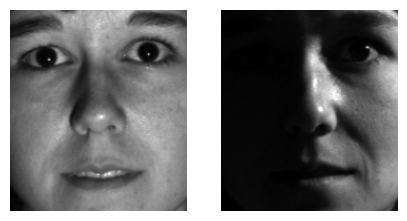



Expected = 31        Predicted = 31


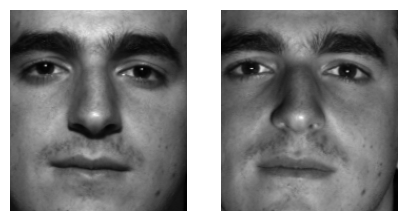



Expected = 37        Predicted = 37


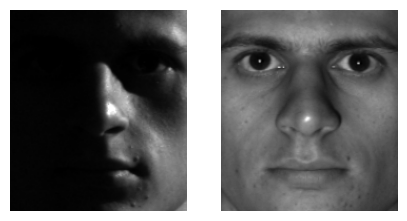



Expected = 5        Predicted = 5


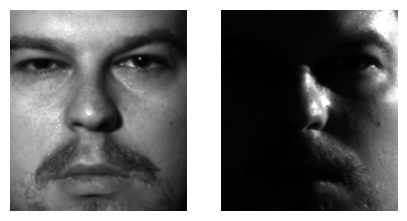



Expected = 35        Predicted = 35


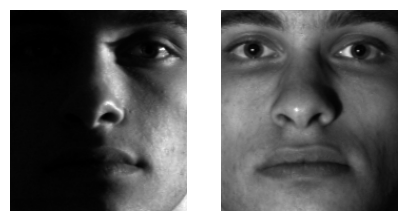



Expected = 28        Predicted = 28


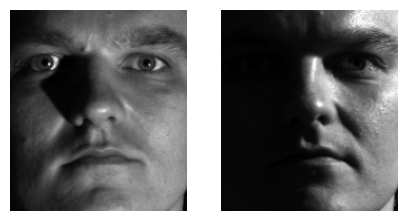



Expected = 20        Predicted = 20


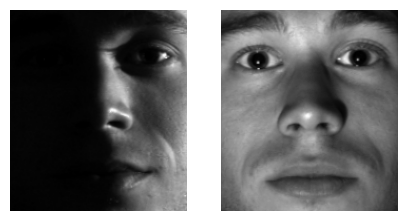



Expected = 10        Predicted = 10


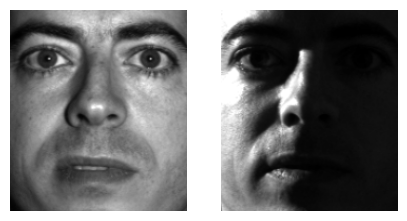



Expected = 8        Predicted = 8


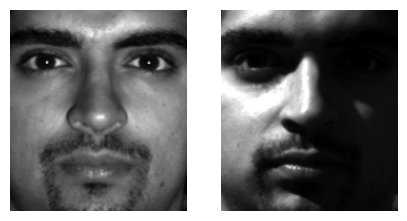



Expected = 6        Predicted = 6


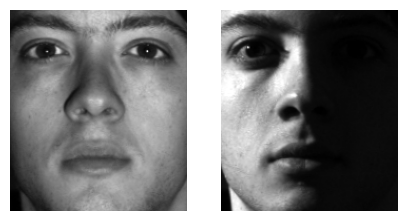



Expected = 18        Predicted = 18


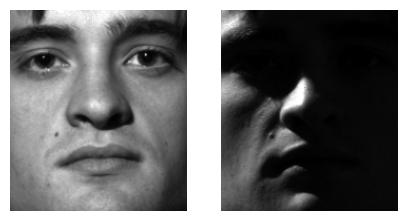



Expected = 1        Predicted = 1


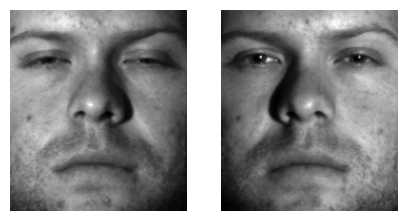



Expected = 32        Predicted = 32


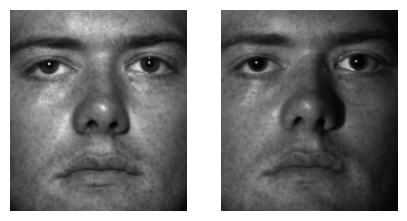



Expected = 36        Predicted = 36


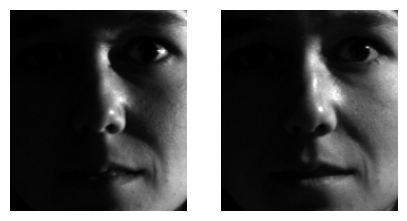



Expected = 2        Predicted = 2


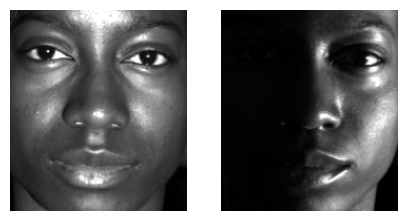



Expected = 33        Predicted = 33


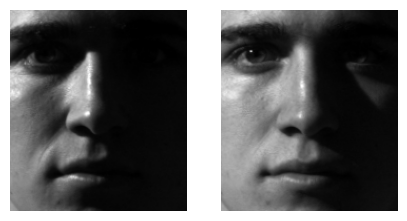



Expected = 14        Predicted = 14


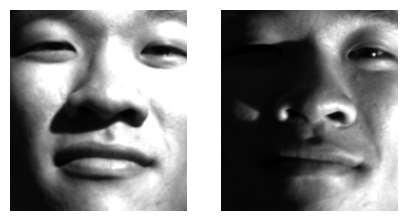



Expected = 0        Predicted = 0


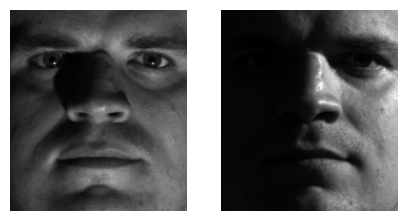



Expected = 36        Predicted = 36


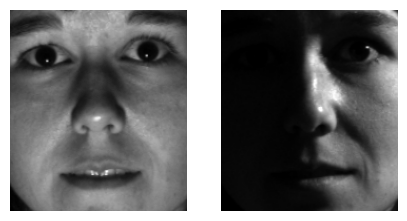



Expected = 16        Predicted = 16


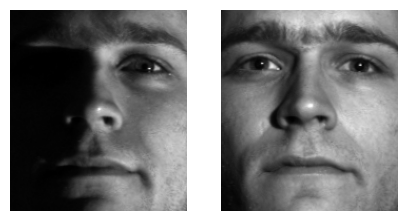



Expected = 27        Predicted = 27


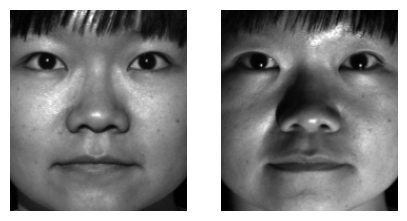



Expected = 28        Predicted = 28


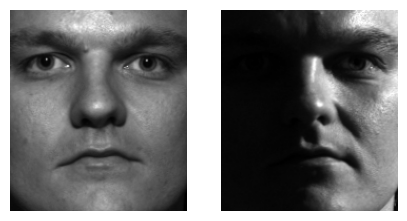



Expected = 8        Predicted = 8


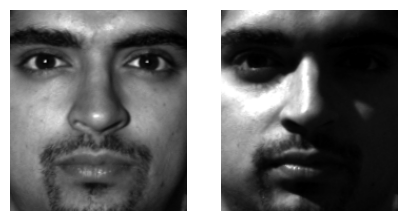



Expected = 29        Predicted = 29


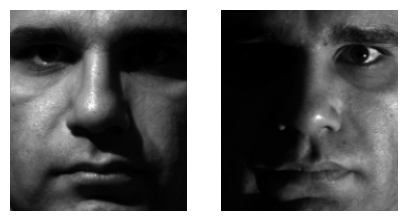



Expected = 29        Predicted = 29


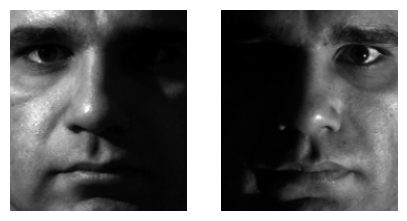



Expected = 30        Predicted = 30


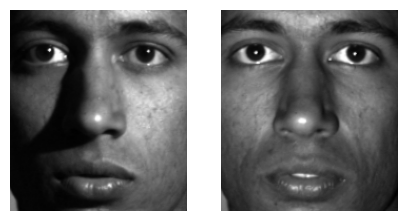



Expected = 3        Predicted = 3


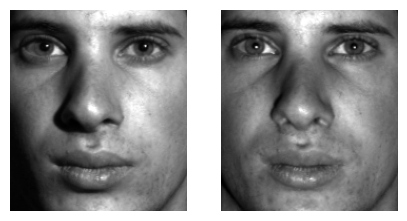



Expected = 36        Predicted = 36


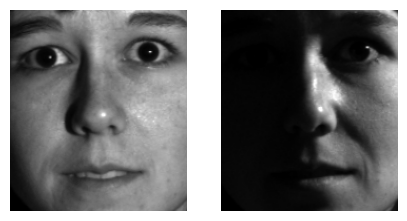



Expected = 23        Predicted = 23


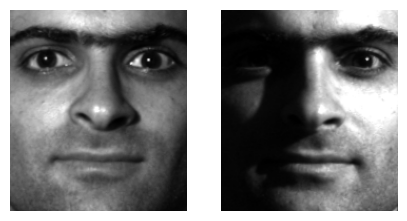



Expected = 18        Predicted = 18


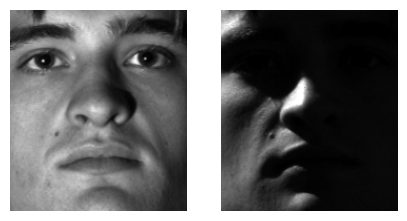



Expected = 2        Predicted = 2


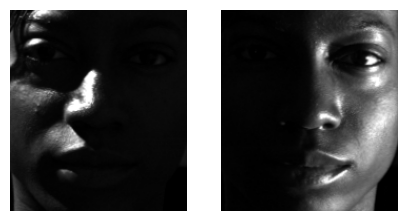



Expected = 13        Predicted = 13


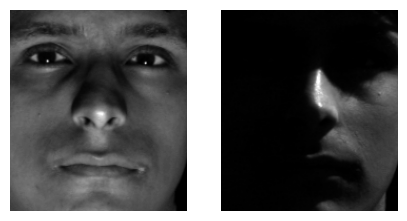



Expected = 4        Predicted = 4


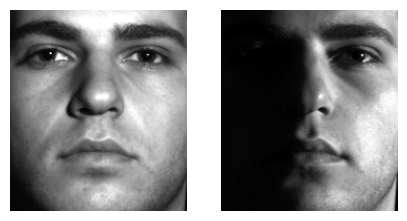



Expected = 32        Predicted = 32


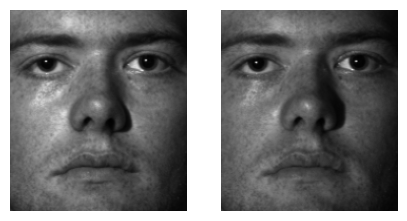



Expected = 19        Predicted = 19


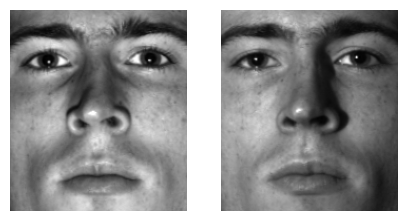



Expected = 2        Predicted = 2


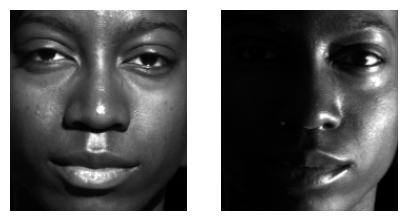



Expected = 37        Predicted = 37


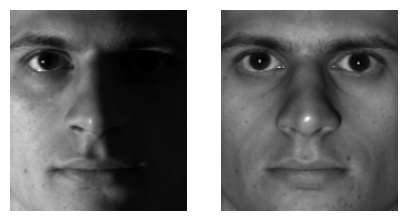



Expected = 5        Predicted = 5


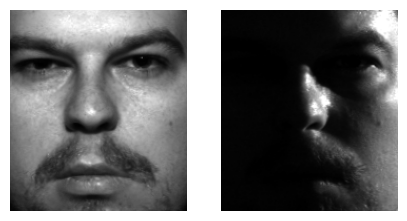



Expected = 1        Predicted = 1


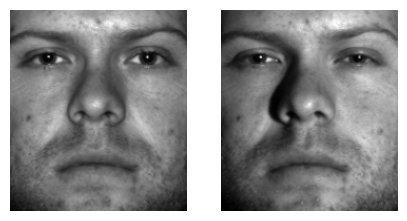



Expected = 7        Predicted = 7


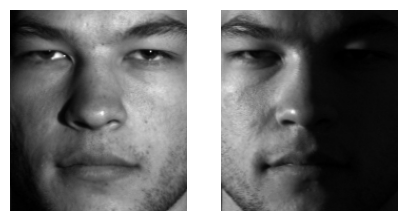



Expected = 27        Predicted = 27


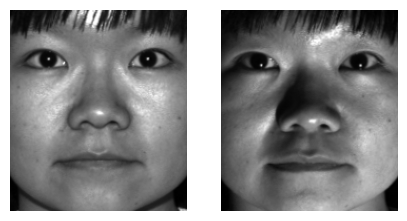



Expected = 7        Predicted = 7


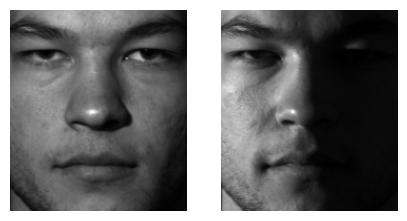



Expected = 9        Predicted = 9


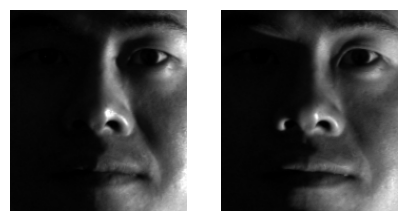



Expected = 0        Predicted = 0


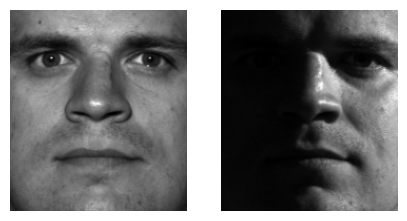



Expected = 35        Predicted = 35


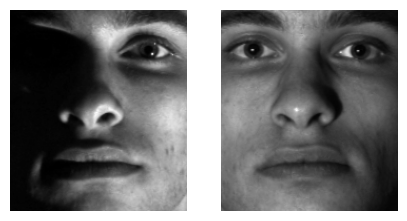



Expected = 3        Predicted = 3


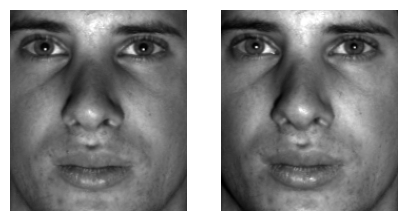



Expected = 37        Predicted = 37


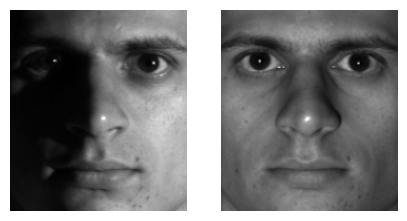



Expected = 10        Predicted = 10


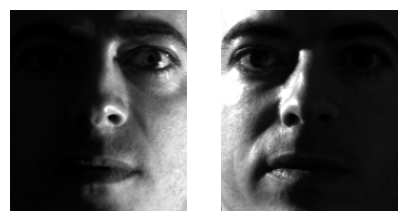



Expected = 31        Predicted = 31


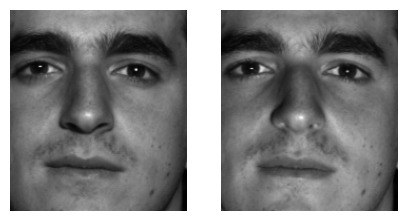



Expected = 14        Predicted = 14


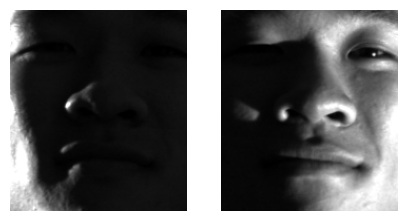



Expected = 26        Predicted = 26


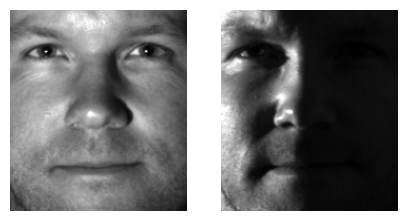



Expected = 29        Predicted = 29


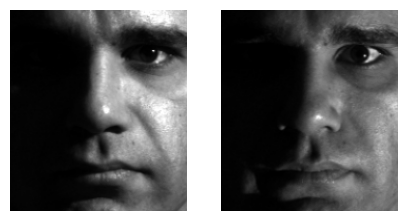



Expected = 24        Predicted = 24


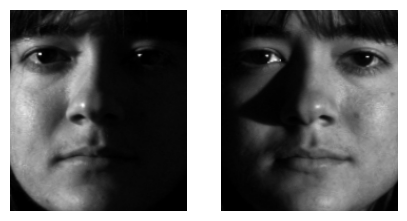



Expected = 2        Predicted = 2


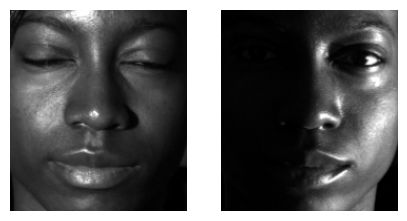



Expected = 19        Predicted = 19


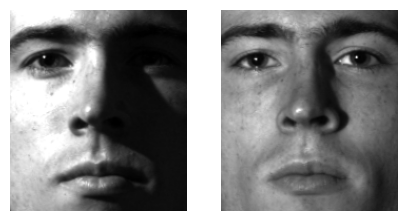



Expected = 26        Predicted = 26


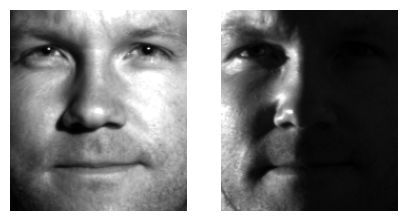



Expected = 37        Predicted = 37


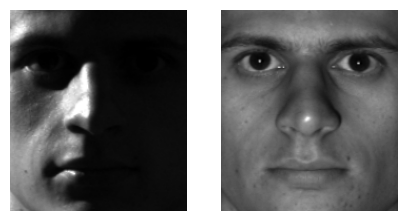



Expected = 13        Predicted = 13


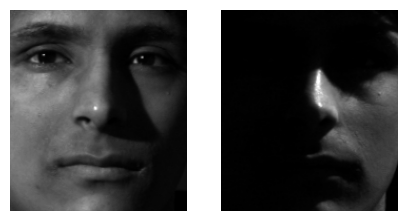



Expected = 7        Predicted = 7


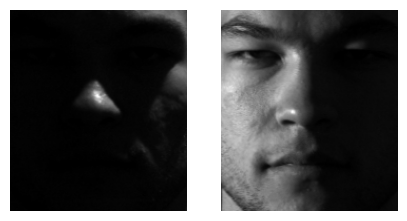



Expected = 8        Predicted = 8


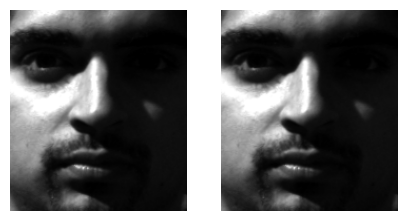



Expected = 17        Predicted = 17


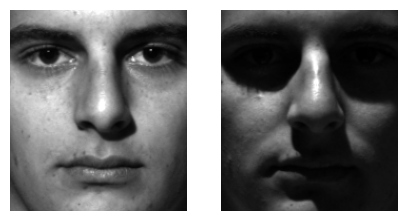



Expected = 9        Predicted = 9


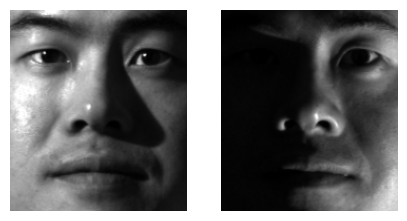



Expected = 4        Predicted = 4


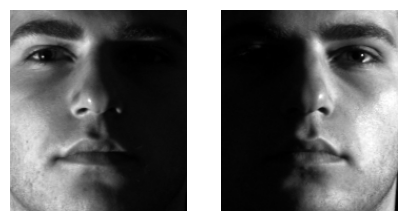



Expected = 4        Predicted = 4


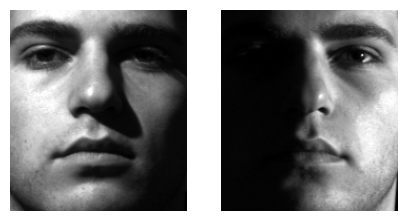



Expected = 23        Predicted = 23


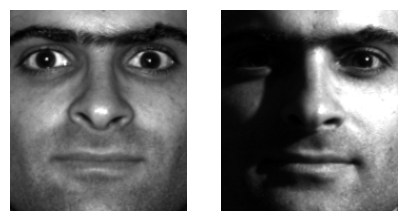



Expected = 2        Predicted = 2


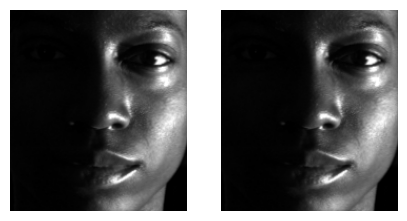



Expected = 2        Predicted = 2


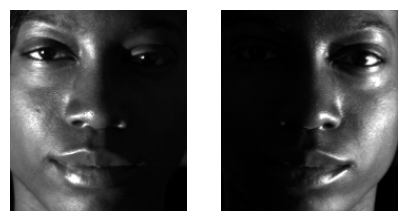



Expected = 21        Predicted = 21


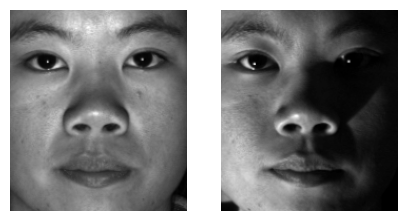



Expected = 0        Predicted = 0


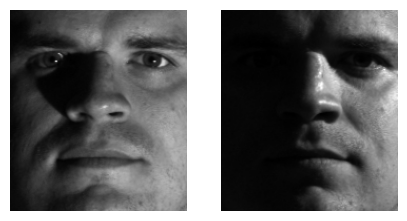



Expected = 19        Predicted = 19


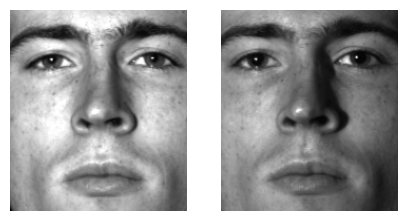



Expected = 21        Predicted = 21


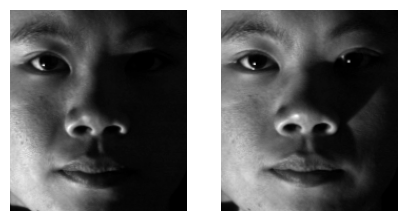



Expected = 13        Predicted = 13


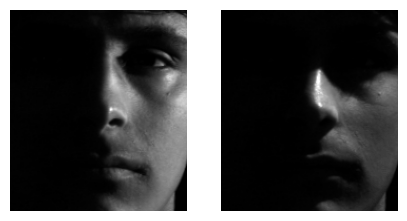



Expected = 31        Predicted = 31


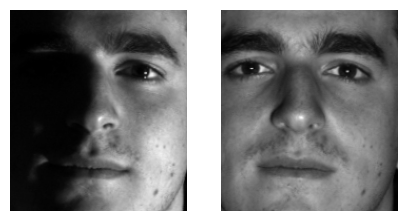



Expected = 9        Predicted = 9


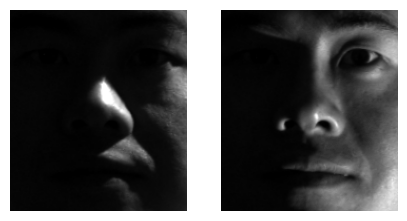



Expected = 1        Predicted = 1


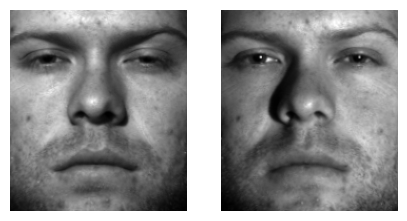



Expected = 31        Predicted = 31


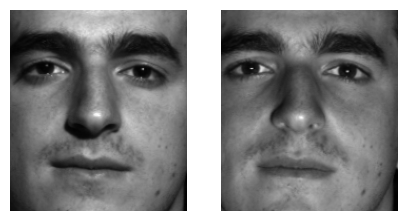



Expected = 11        Predicted = 11


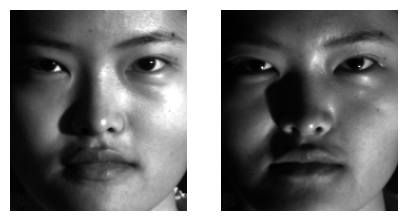



Expected = 25        Predicted = 25


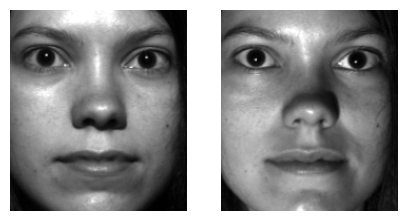



Expected = 33        Predicted = 33


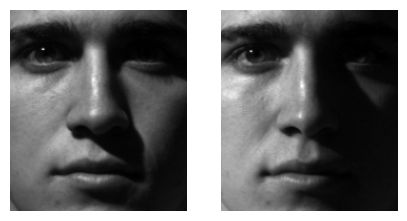



Expected = 35        Predicted = 35


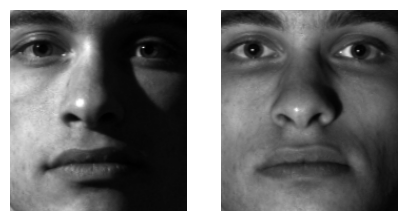



Expected = 13        Predicted = 13


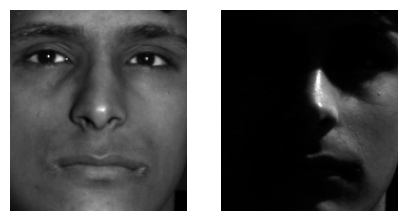



Expected = 20        Predicted = 20


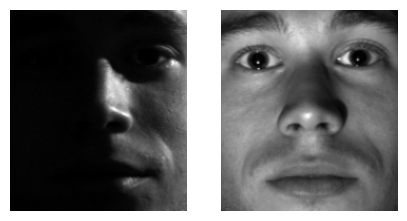



Expected = 3        Predicted = 3


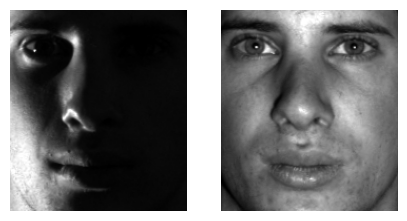



Expected = 37        Predicted = 37


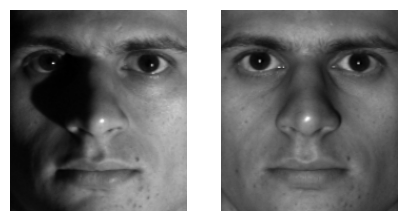



Expected = 20        Predicted = 20


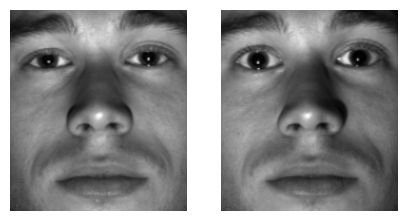



Expected = 12        Predicted = 12


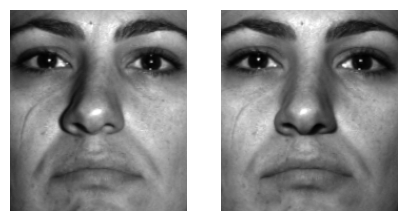



Expected = 7        Predicted = 7


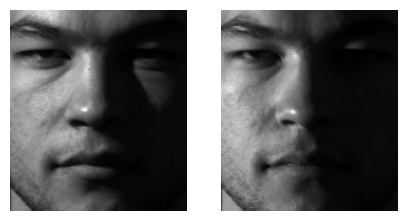



Expected = 25        Predicted = 25


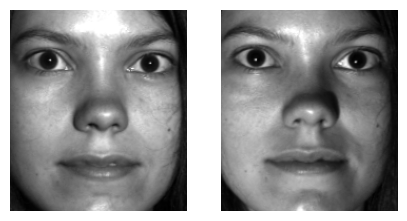



Expected = 29        Predicted = 29


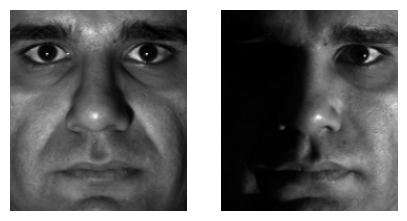



Expected = 29        Predicted = 29


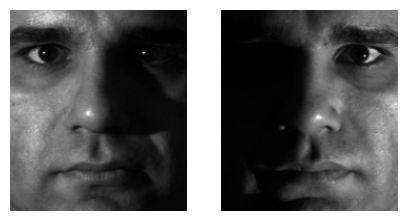



Expected = 8        Predicted = 8


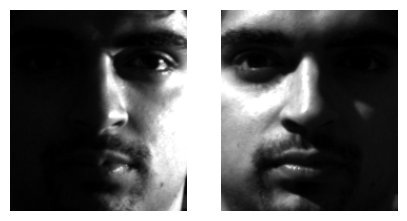



Expected = 2        Predicted = 2


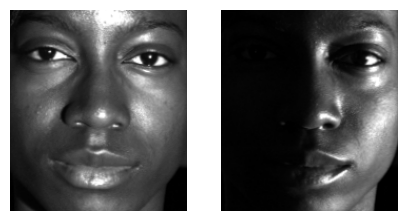



Expected = 15        Predicted = 15


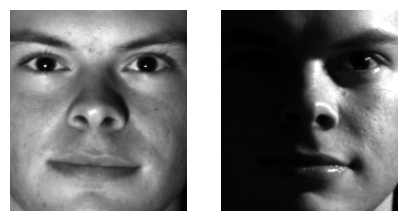



Expected = 18        Predicted = 18


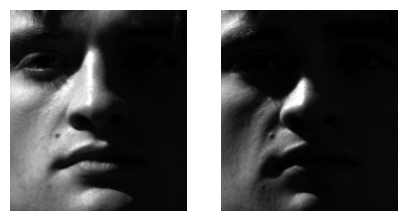



Expected = 35        Predicted = 35


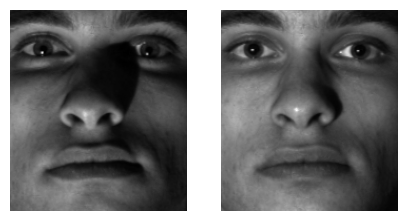



Expected = 27        Predicted = 27


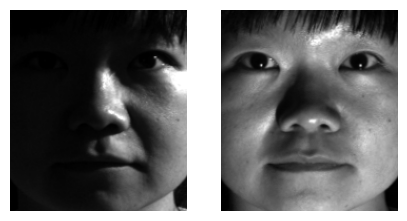



Expected = 32        Predicted = 32


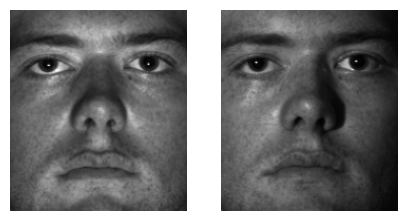



Expected = 19        Predicted = 19


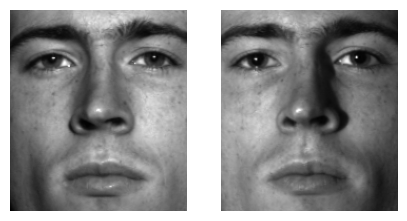



Expected = 27        Predicted = 27


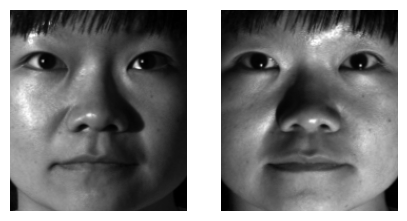



Expected = 24        Predicted = 24


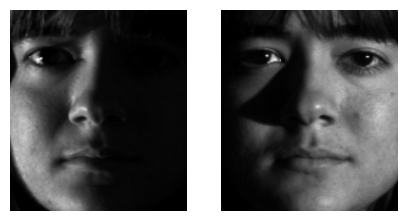



Expected = 32        Predicted = 32


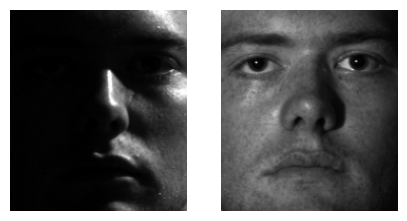



Expected = 22        Predicted = 22


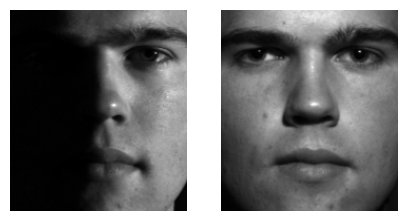



Expected = 8        Predicted = 8


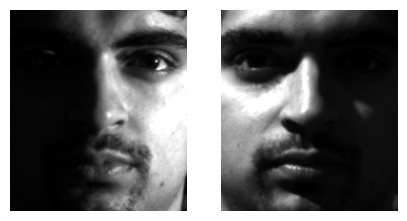



Expected = 4        Predicted = 4


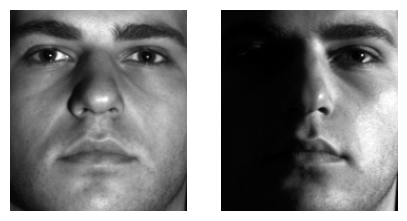



Expected = 9        Predicted = 9


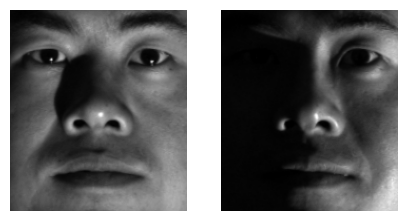



Expected = 26        Predicted = 26


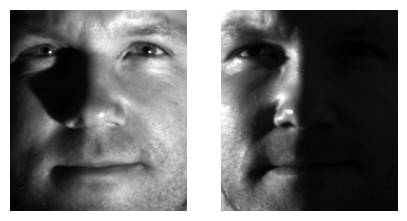



Expected = 27        Predicted = 27


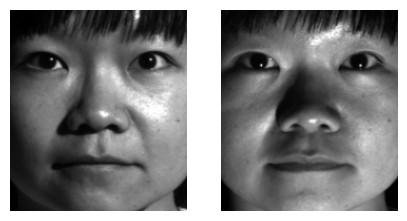



Expected = 25        Predicted = 25


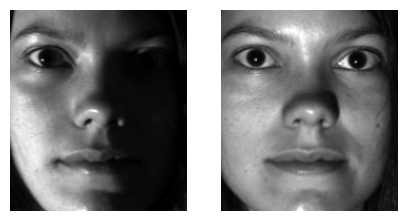



Expected = 21        Predicted = 21


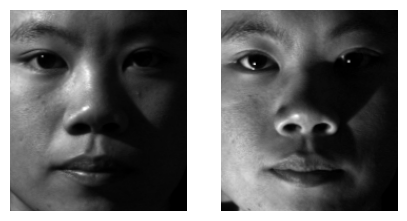



Expected = 31        Predicted = 31


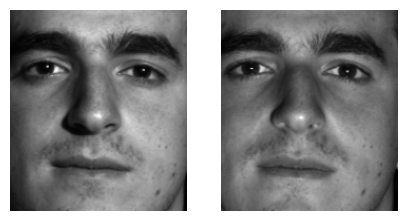



Expected = 1        Predicted = 1


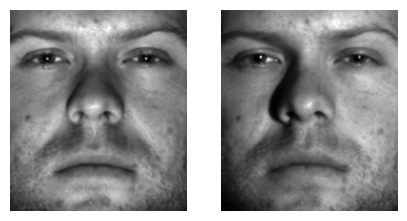



Expected = 18        Predicted = 18


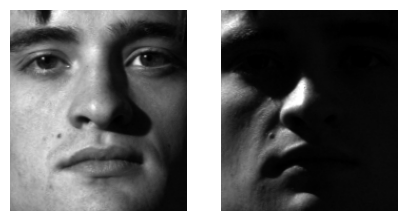



Expected = 18        Predicted = 18


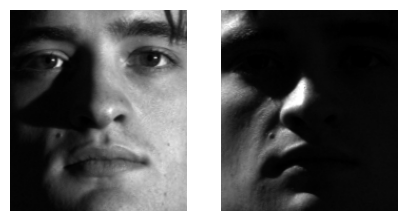



Expected = 35        Predicted = 35


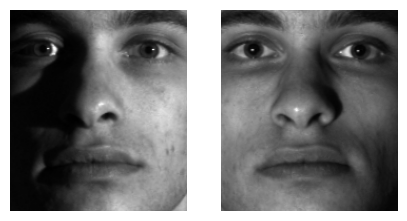



Expected = 26        Predicted = 26


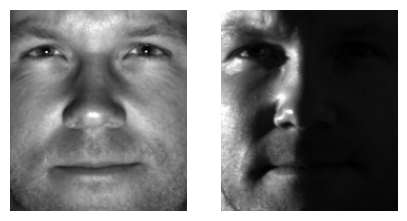



Expected = 1        Predicted = 1


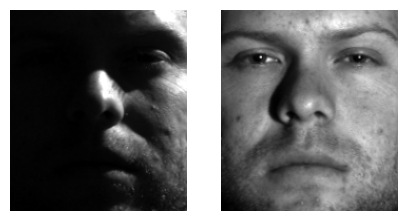



Expected = 28        Predicted = 28


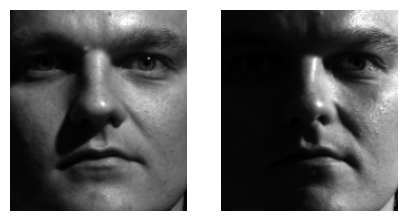



Expected = 2        Predicted = 2


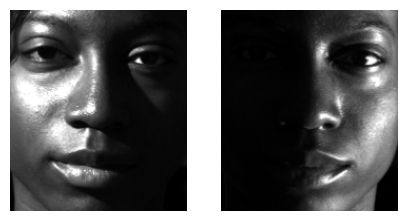



Expected = 9        Predicted = 9


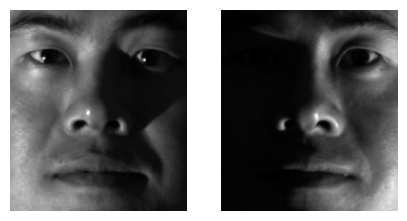



Expected = 5        Predicted = 5


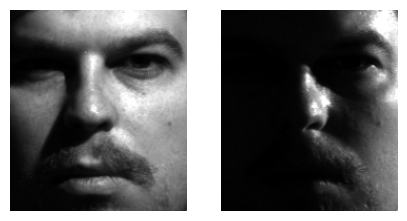



Expected = 35        Predicted = 35


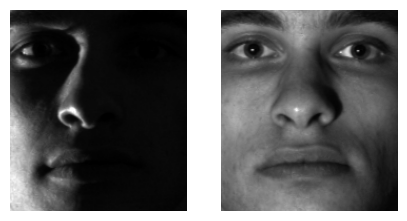



Expected = 10        Predicted = 10


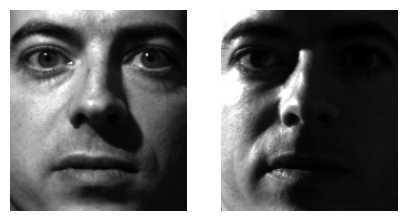



Expected = 29        Predicted = 29


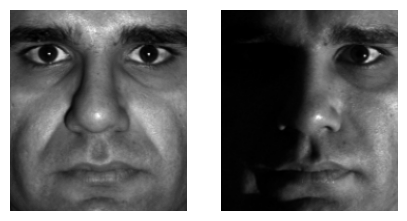



Expected = 13        Predicted = 13


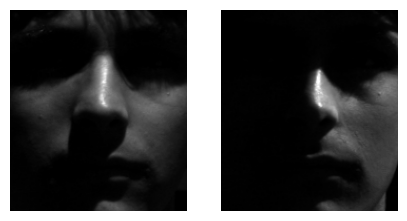



Expected = 4        Predicted = 4


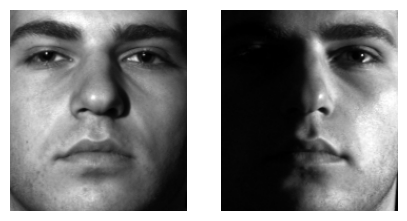



Expected = 24        Predicted = 24


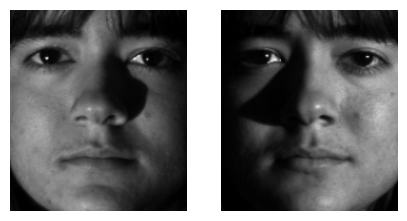



Expected = 20        Predicted = 20


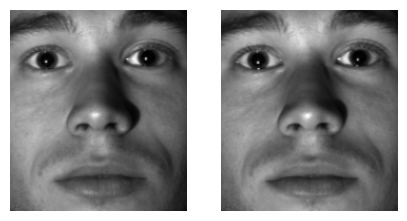



Expected = 9        Predicted = 9


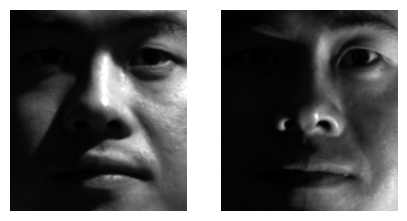



Expected = 21        Predicted = 21


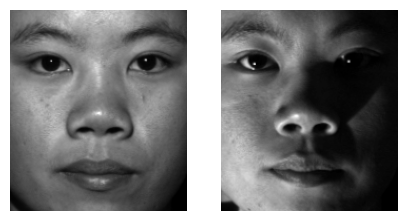



Expected = 30        Predicted = 30


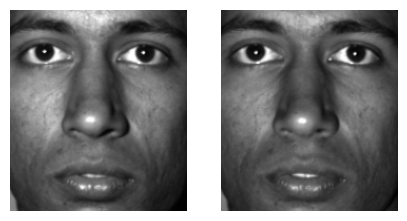



Expected = 31        Predicted = 31


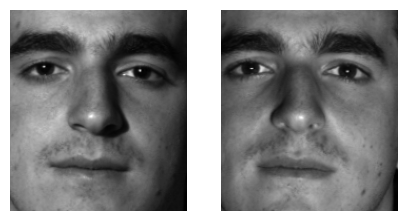



Expected = 32        Predicted = 32


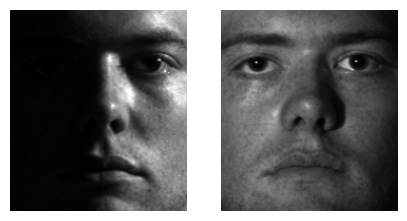



Expected = 37        Predicted = 37


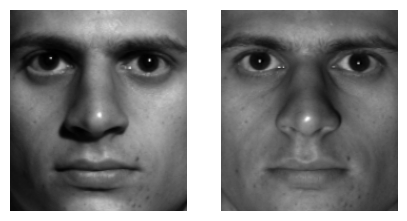



Expected = 21        Predicted = 21


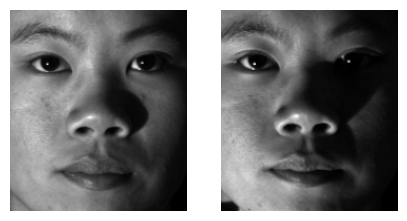



Expected = 17        Predicted = 17


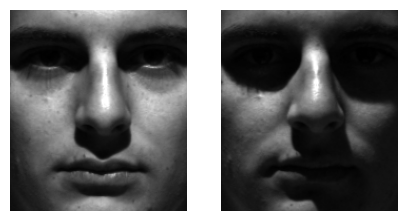



Expected = 18        Predicted = 18


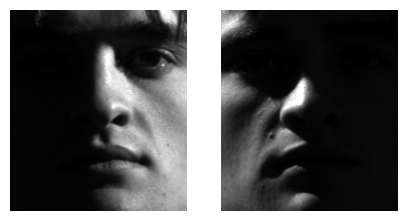



Expected = 22        Predicted = 22


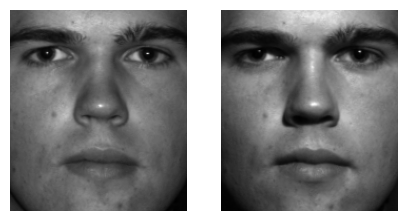



Expected = 34        Predicted = 34


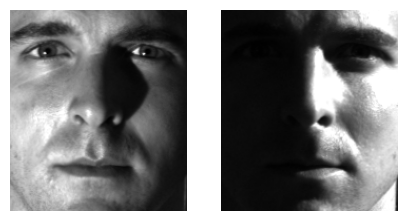



Expected = 4        Predicted = 4


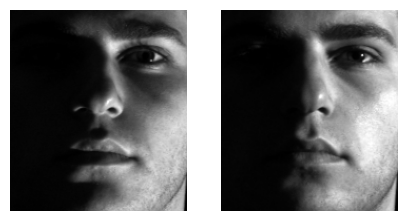



Expected = 6        Predicted = 6


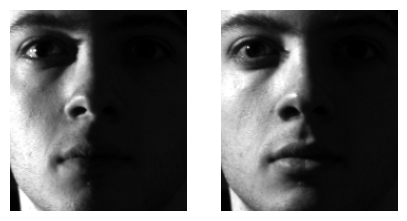



Expected = 27        Predicted = 27


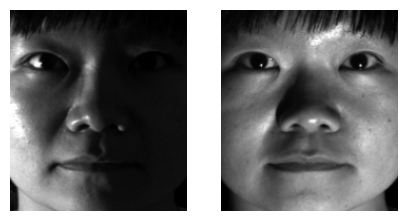



Expected = 3        Predicted = 3


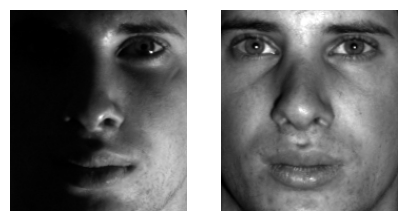



Expected = 30        Predicted = 30


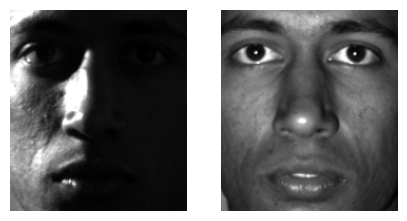



Expected = 3        Predicted = 3


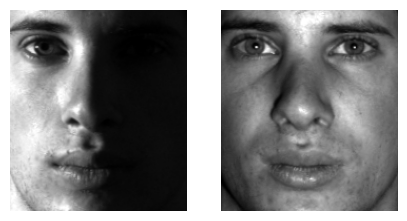



Expected = 37        Predicted = 37


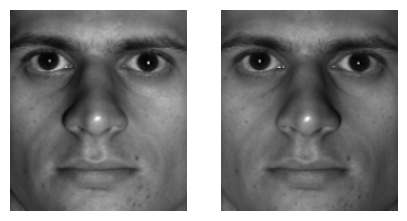



Expected = 33        Predicted = 33


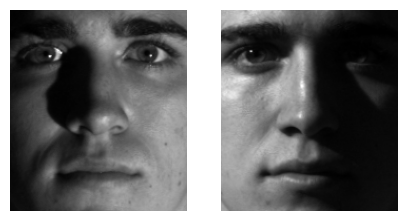



Expected = 34        Predicted = 34


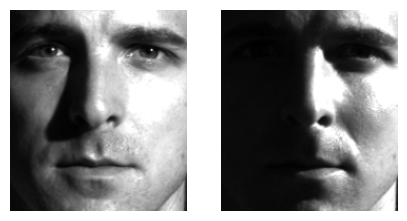



Expected = 17        Predicted = 17


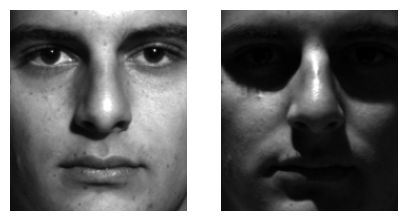



Expected = 6        Predicted = 6


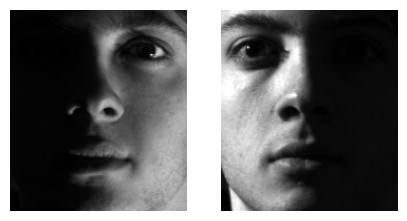



Expected = 31        Predicted = 31


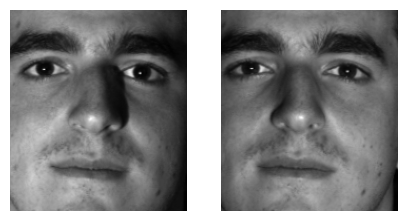



Expected = 22        Predicted = 22


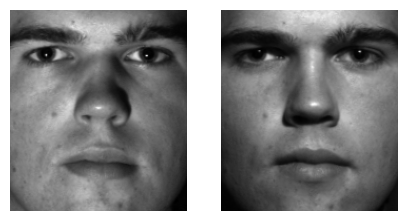



Expected = 3        Predicted = 3


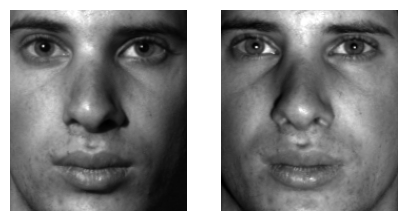



Expected = 10        Predicted = 10


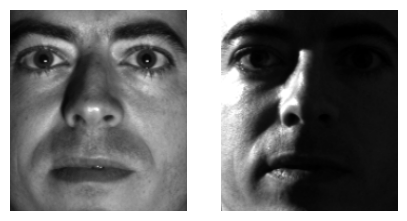



Expected = 11        Predicted = 11


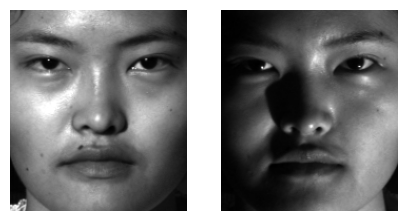



Expected = 32        Predicted = 32


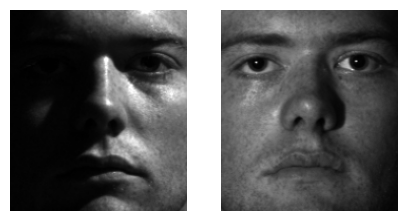



Expected = 16        Predicted = 16


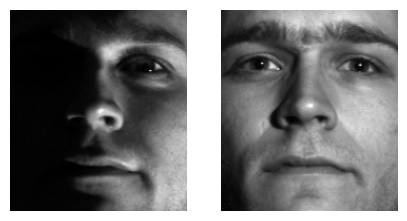



Expected = 30        Predicted = 30


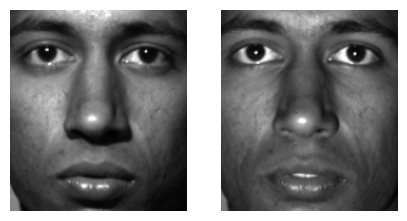



Expected = 35        Predicted = 35


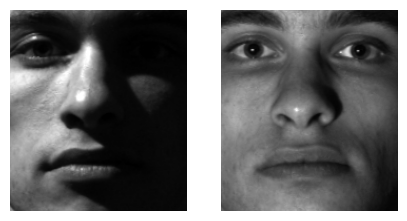



Expected = 25        Predicted = 25


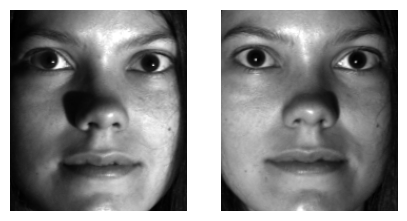



Expected = 5        Predicted = 5


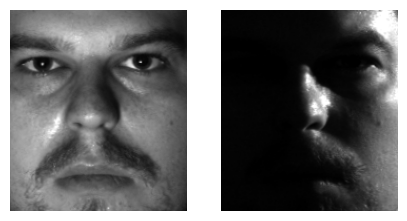



Expected = 21        Predicted = 21


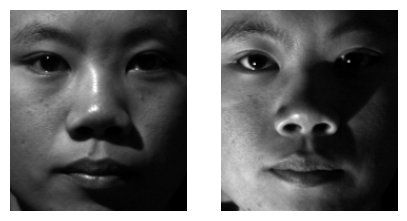



Expected = 21        Predicted = 21


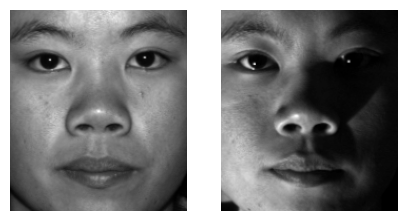



Expected = 35        Predicted = 35


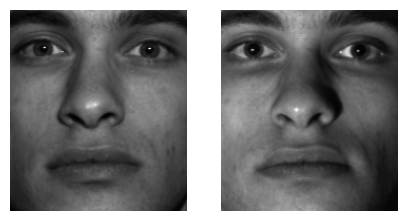



Expected = 23        Predicted = 23


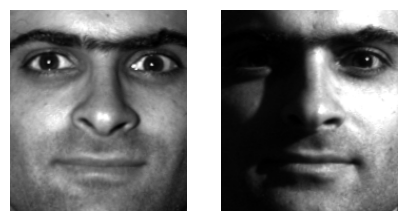



Expected = 22        Predicted = 22


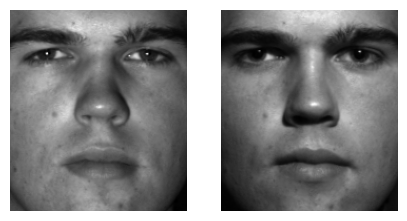



Expected = 4        Predicted = 4


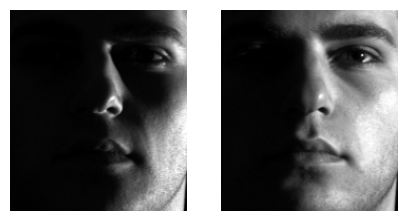



Expected = 1        Predicted = 1


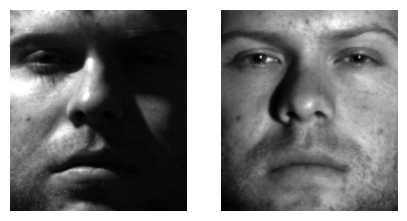



Expected = 20        Predicted = 20


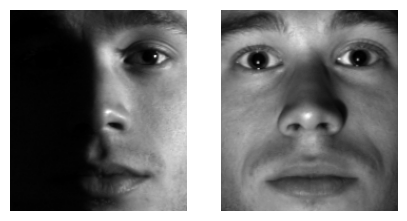



Expected = 13        Predicted = 13


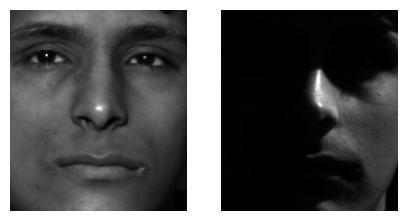



Expected = 21        Predicted = 21


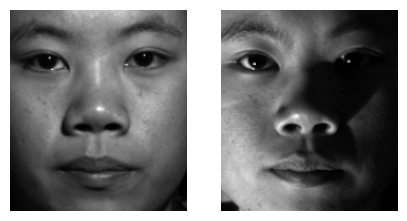



Expected = 3        Predicted = 3


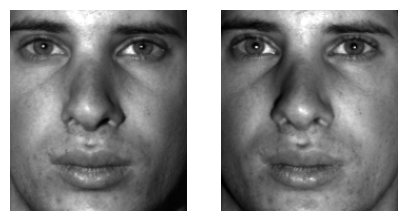



Expected = 35        Predicted = 35


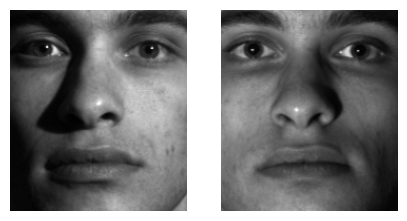



Expected = 13        Predicted = 13


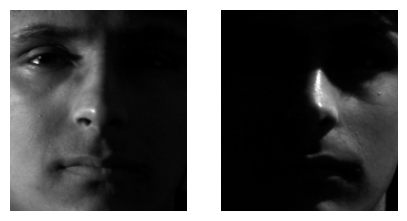



Expected = 24        Predicted = 24


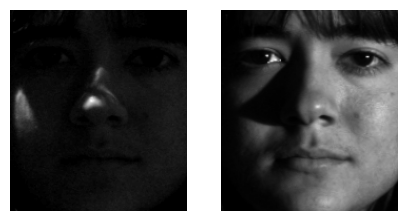



Expected = 7        Predicted = 7


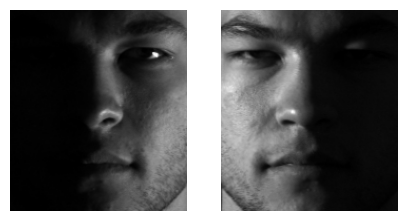



Expected = 16        Predicted = 16


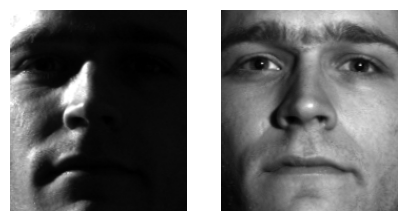



Expected = 12        Predicted = 12


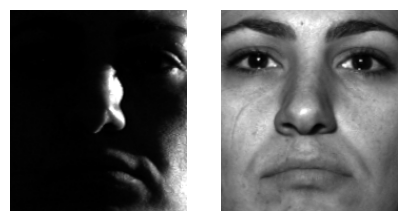



Expected = 26        Predicted = 26


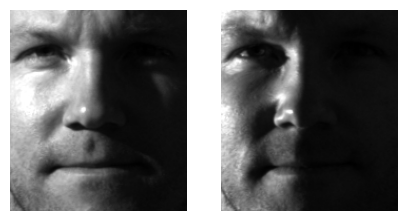



Expected = 19        Predicted = 19


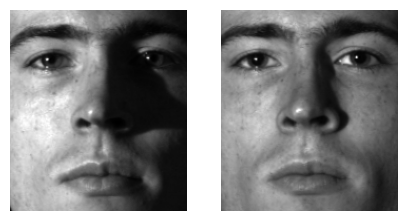



Expected = 31        Predicted = 31


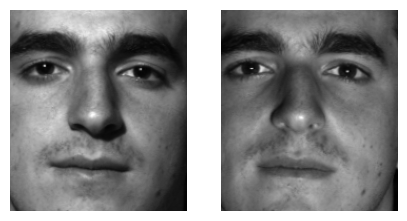



Expected = 0        Predicted = 0


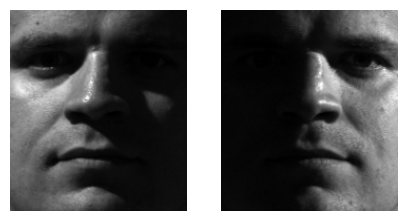



Expected = 5        Predicted = 5


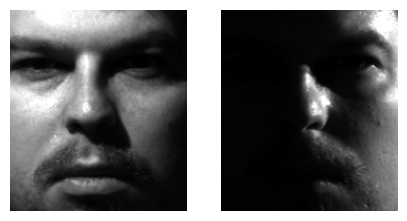



Expected = 5        Predicted = 5


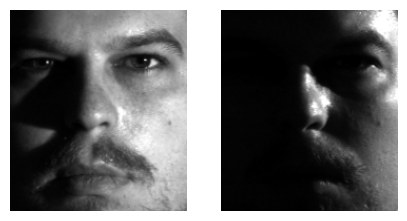



Expected = 17        Predicted = 17


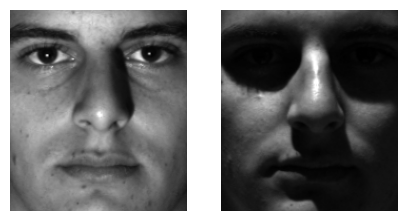



Expected = 36        Predicted = 36


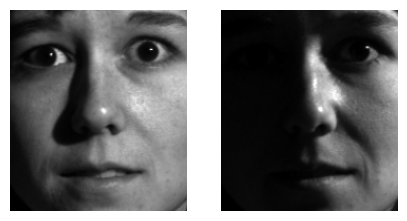



Expected = 12        Predicted = 12


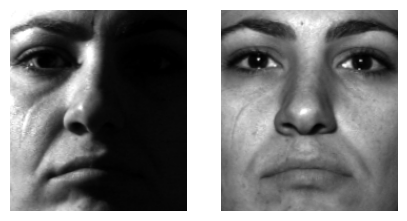



Expected = 21        Predicted = 21


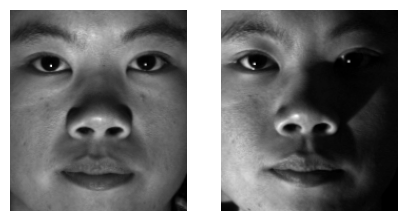



Expected = 35        Predicted = 35


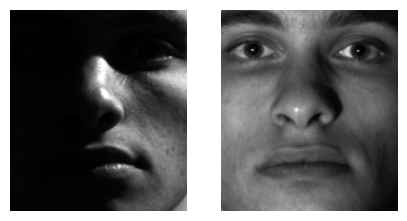

In [8]:
for i in range(len(y_test)):
    if correct[i] == 1:
        print("Expected =", y_test[i], "     ", " Predicted =", predicted[i])
        plot_guesses(X_test[i], X[predicted[i] * 64])


# Print Incorrect Guesses

Expected = 35        Predicted = 6


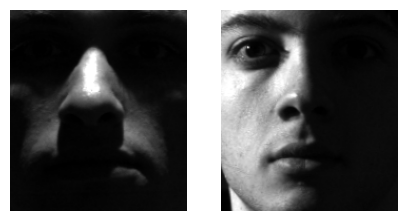



Expected = 29        Predicted = 28


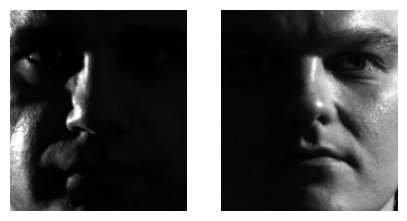



Expected = 9        Predicted = 25


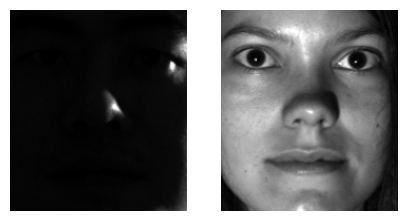



Expected = 8        Predicted = 20


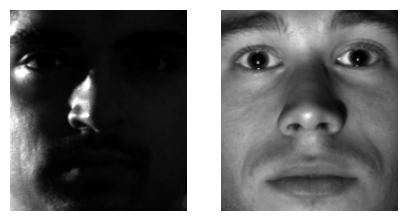



Expected = 14        Predicted = 18


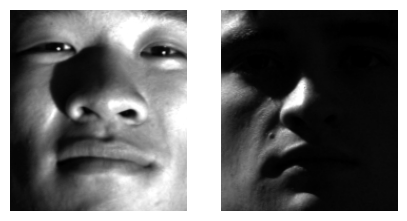



Expected = 34        Predicted = 33


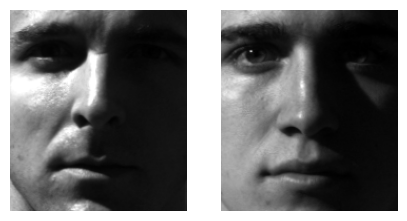



Expected = 0        Predicted = 28


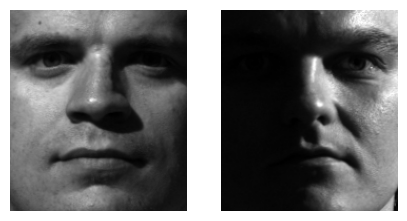



Expected = 36        Predicted = 33


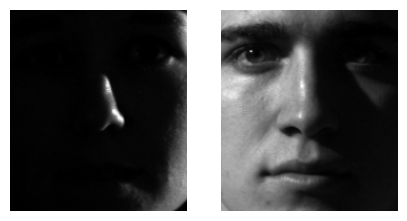



Expected = 30        Predicted = 5


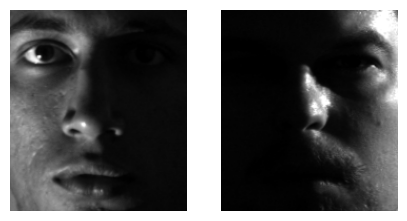



Expected = 16        Predicted = 23


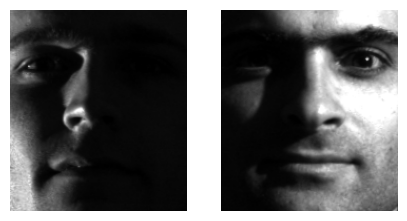



Expected = 6        Predicted = 35


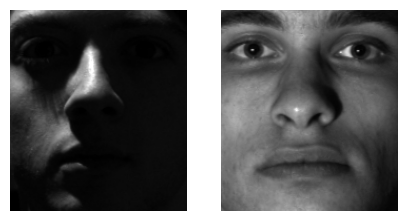



Expected = 28        Predicted = 0


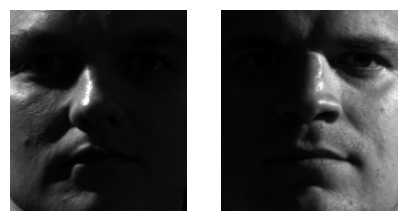



Expected = 36        Predicted = 33


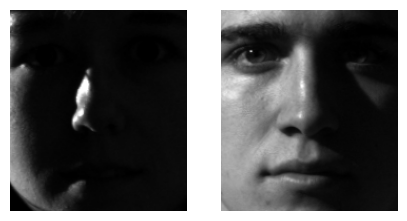



Expected = 19        Predicted = 32


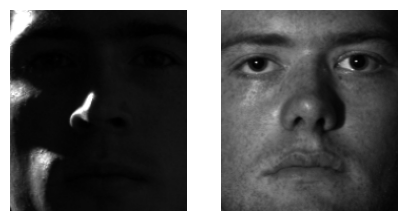



Expected = 29        Predicted = 0


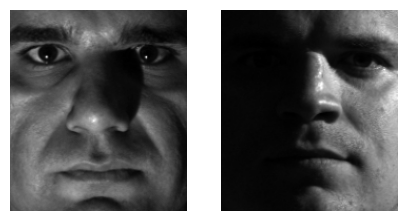



Expected = 25        Predicted = 24


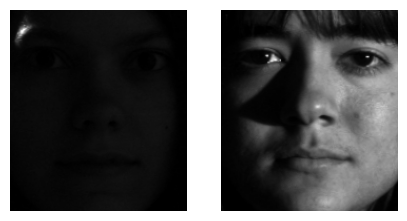



Expected = 6        Predicted = 4


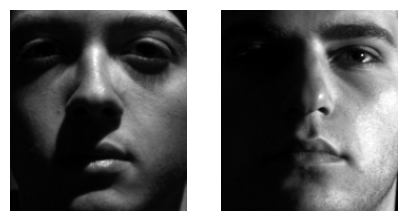



Expected = 27        Predicted = 11


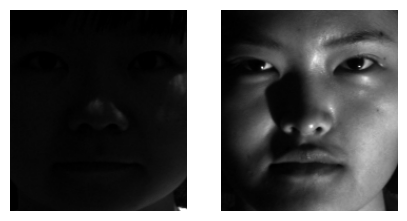



Expected = 15        Predicted = 1


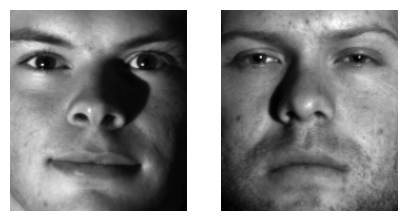



Expected = 26        Predicted = 31


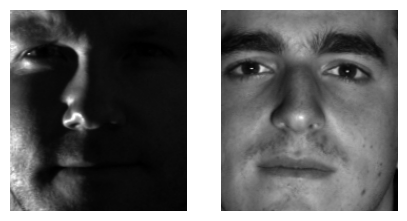



Expected = 36        Predicted = 26


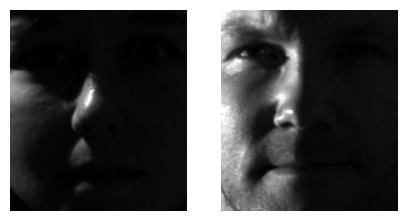



Expected = 20        Predicted = 9


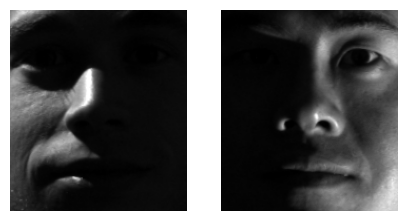



Expected = 36        Predicted = 13


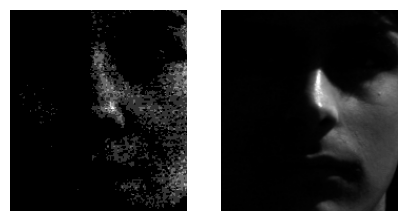



Expected = 14        Predicted = 29


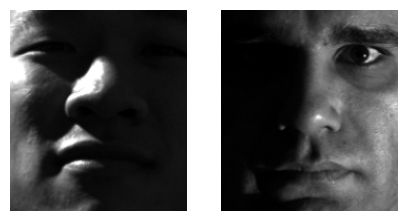



Expected = 21        Predicted = 27


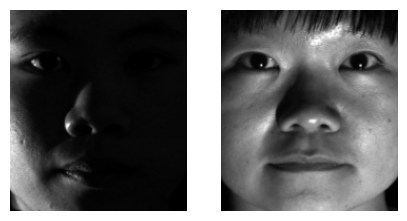



Expected = 28        Predicted = 15


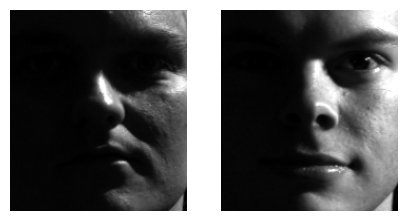



Expected = 1        Predicted = 28


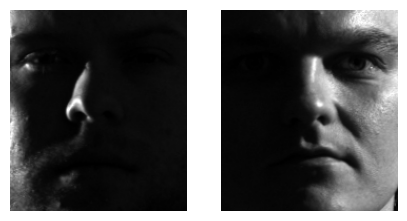



Expected = 15        Predicted = 28


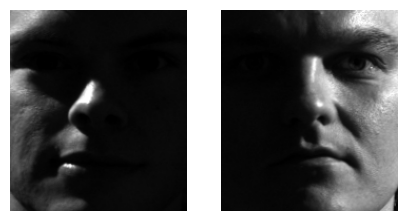



Expected = 17        Predicted = 22


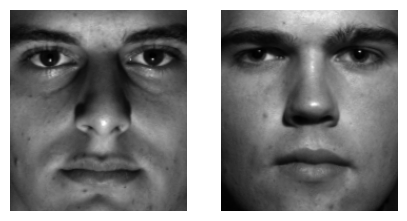



Expected = 21        Predicted = 33


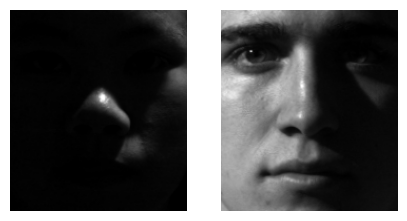



Expected = 3        Predicted = 26


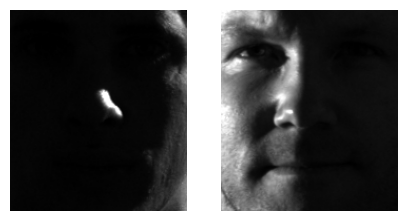



Expected = 35        Predicted = 26


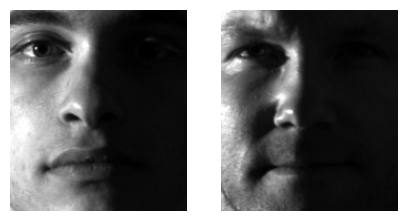



Expected = 0        Predicted = 28


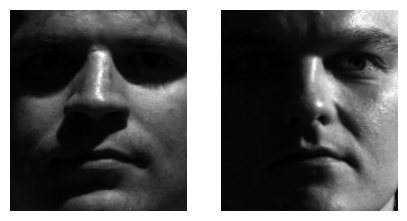



Expected = 6        Predicted = 4


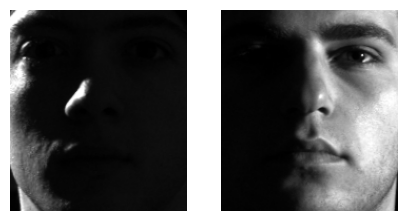



Expected = 37        Predicted = 25


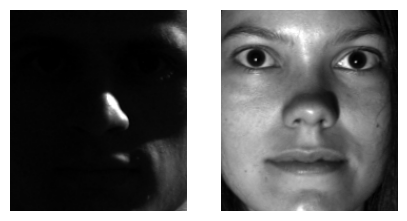



Expected = 26        Predicted = 37


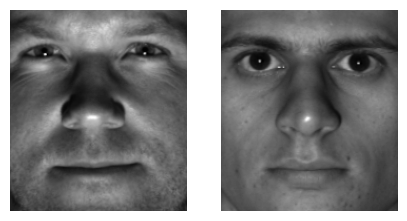



Expected = 11        Predicted = 22


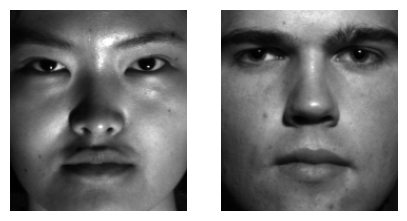



Expected = 3        Predicted = 35


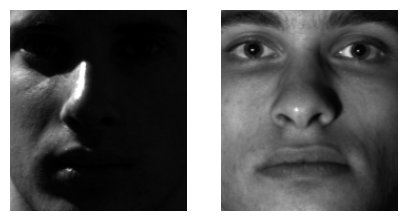



Expected = 23        Predicted = 0


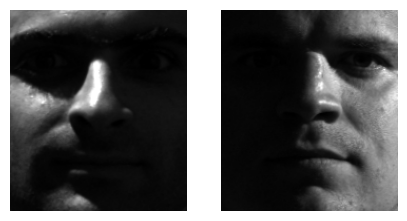



Expected = 33        Predicted = 7


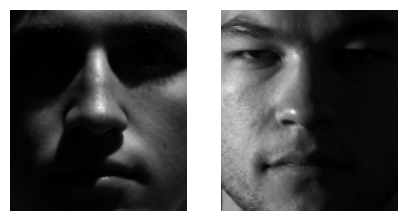



Expected = 20        Predicted = 21


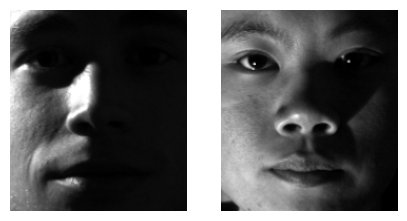



Expected = 3        Predicted = 0


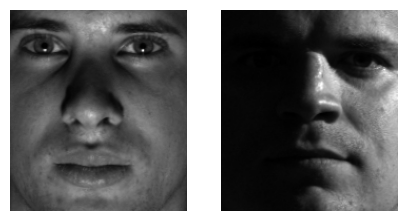



Expected = 28        Predicted = 34


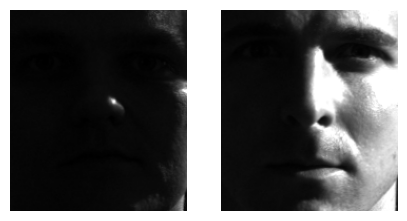



Expected = 27        Predicted = 21


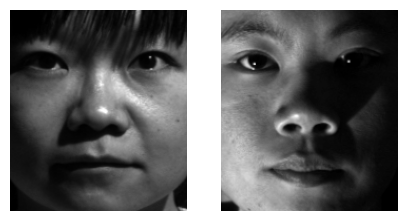



Expected = 26        Predicted = 16


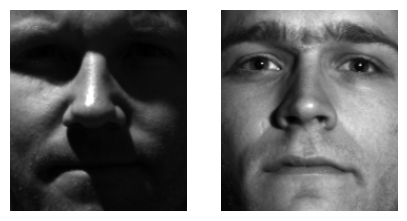



Expected = 22        Predicted = 7


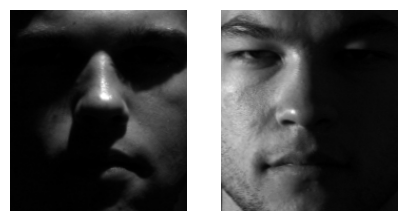



Expected = 4        Predicted = 7


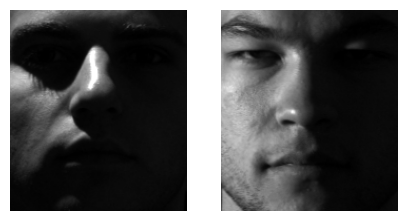



Expected = 24        Predicted = 0


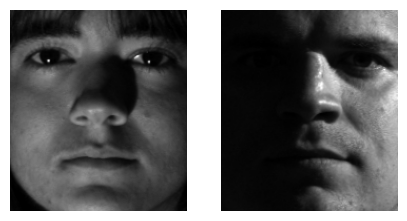



Expected = 14        Predicted = 33


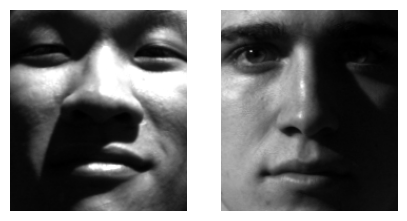



Expected = 25        Predicted = 14


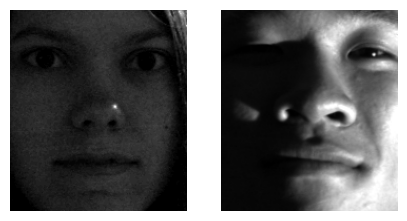



Expected = 0        Predicted = 28


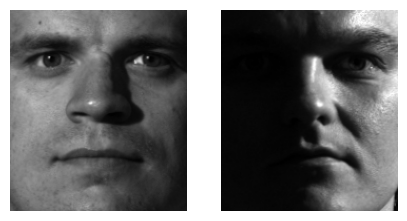



Expected = 34        Predicted = 15


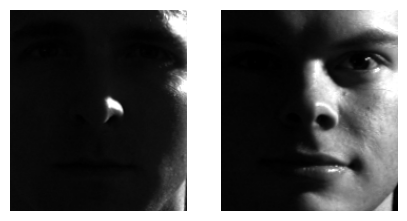



Expected = 12        Predicted = 13


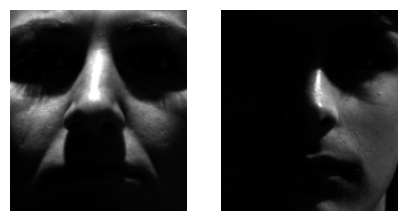



Expected = 32        Predicted = 0


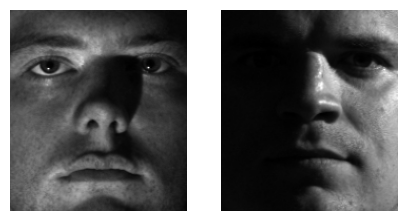



Expected = 22        Predicted = 21


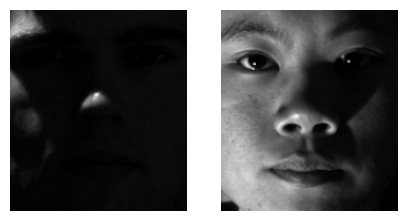



Expected = 30        Predicted = 33


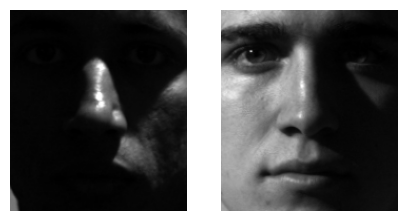



Expected = 18        Predicted = 28


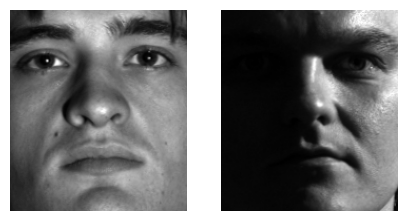



Expected = 21        Predicted = 2


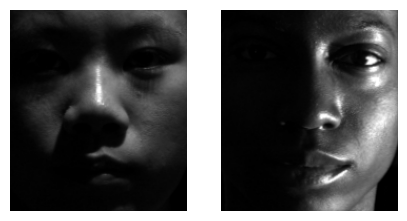



Expected = 18        Predicted = 13


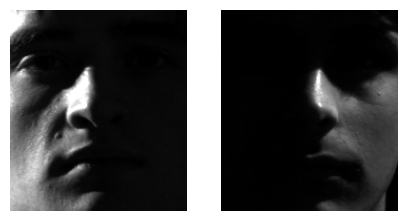



Expected = 22        Predicted = 15


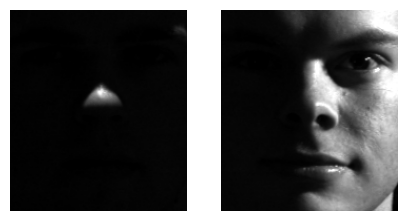



Expected = 15        Predicted = 22


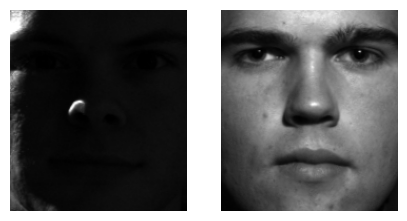



Expected = 20        Predicted = 29


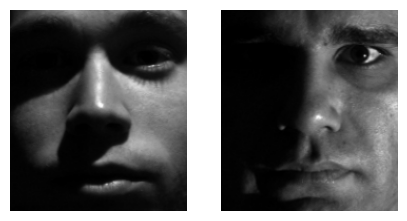



Expected = 37        Predicted = 33


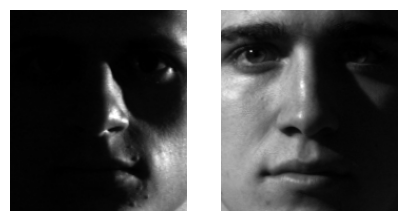



Expected = 6        Predicted = 0


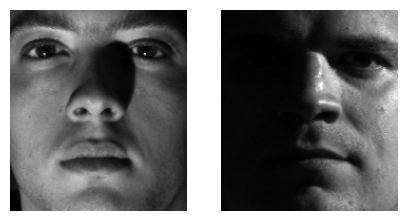



Expected = 3        Predicted = 35


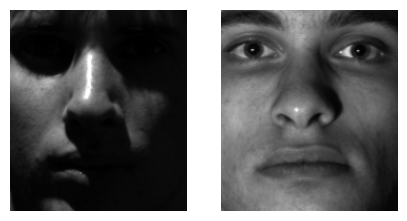



Expected = 12        Predicted = 15


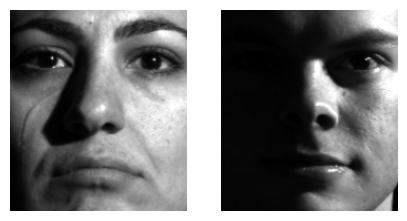



Expected = 7        Predicted = 21


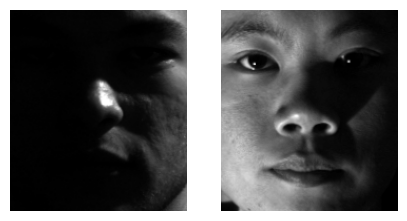



Expected = 25        Predicted = 16


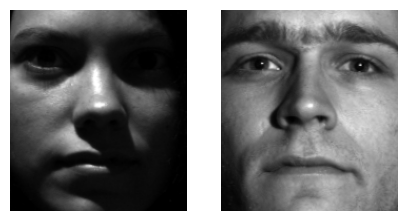



Expected = 17        Predicted = 22


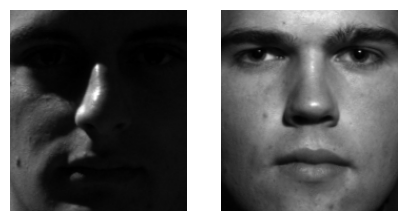



Expected = 29        Predicted = 5


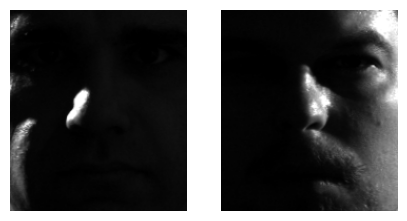



Expected = 23        Predicted = 22


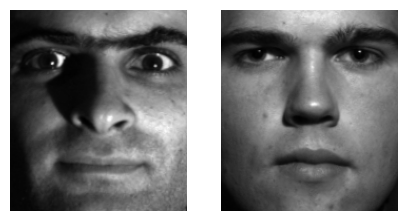



Expected = 20        Predicted = 0


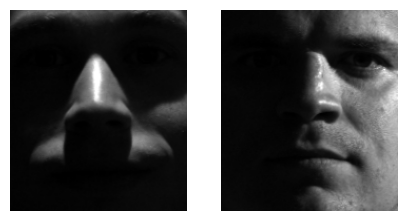



Expected = 23        Predicted = 33


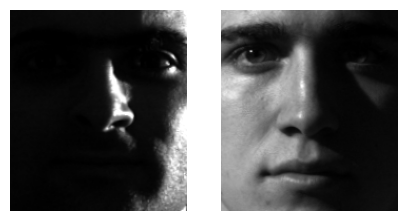



Expected = 24        Predicted = 13


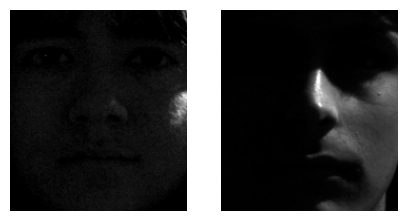



Expected = 36        Predicted = 13


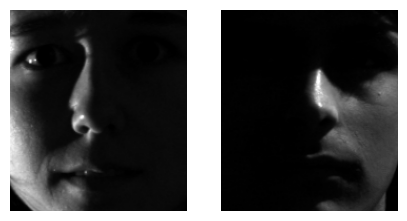



Expected = 36        Predicted = 34


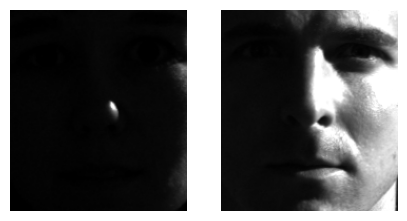



Expected = 9        Predicted = 14


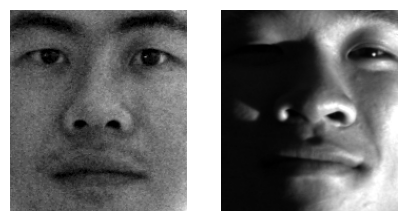



Expected = 18        Predicted = 28


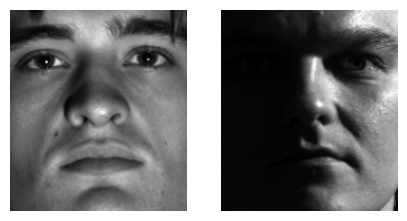



Expected = 6        Predicted = 35


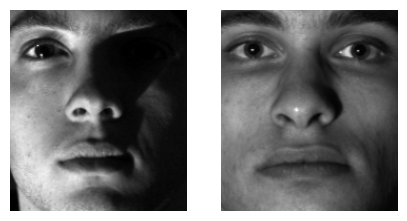



Expected = 25        Predicted = 13


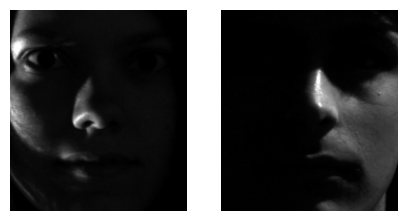



Expected = 12        Predicted = 6


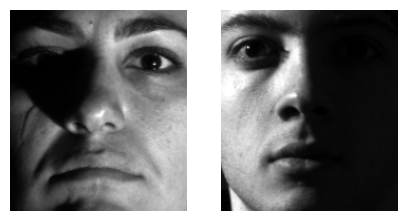



Expected = 36        Predicted = 14


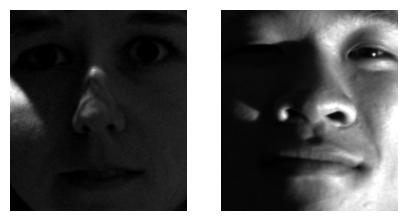



Expected = 23        Predicted = 32


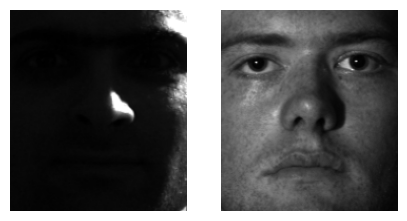



Expected = 26        Predicted = 33


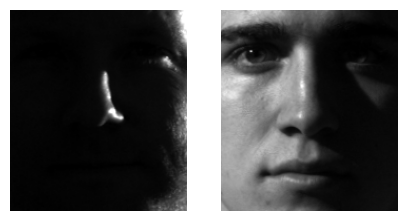



Expected = 1        Predicted = 22


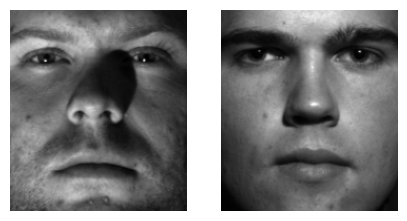



Expected = 26        Predicted = 7


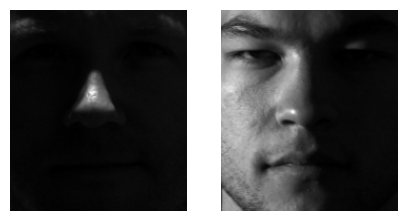



Expected = 30        Predicted = 21


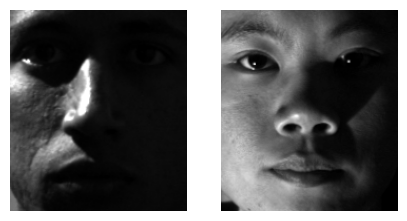



Expected = 30        Predicted = 33


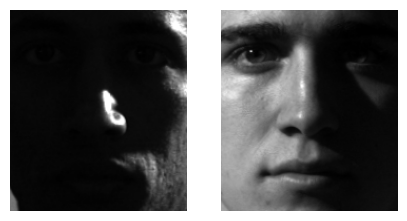



Expected = 26        Predicted = 33


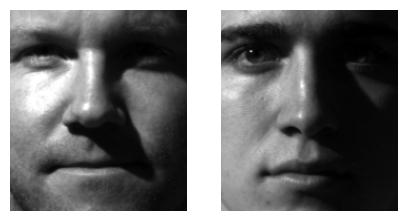



Expected = 17        Predicted = 33


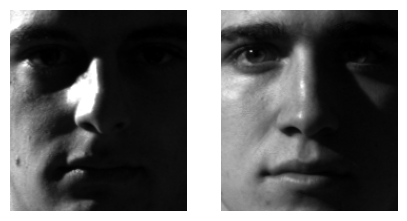



Expected = 3        Predicted = 0


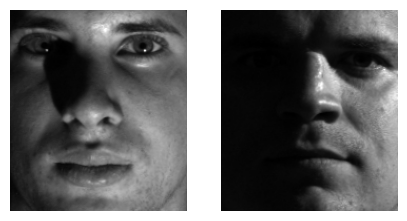



Expected = 36        Predicted = 33


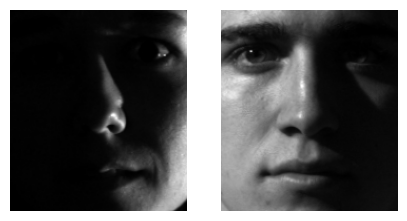



Expected = 4        Predicted = 22


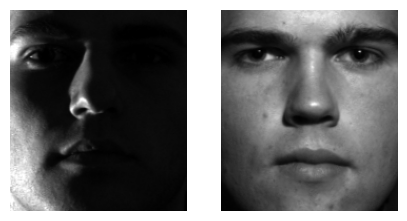



Expected = 8        Predicted = 7


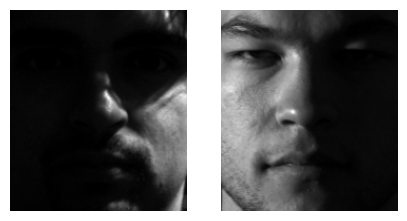



Expected = 22        Predicted = 25


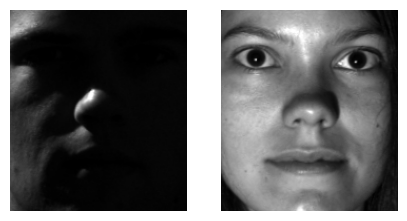



Expected = 30        Predicted = 7


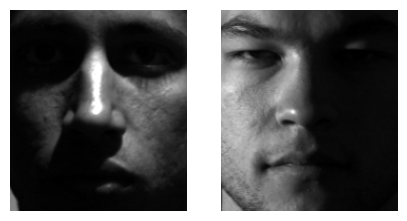



Expected = 4        Predicted = 18


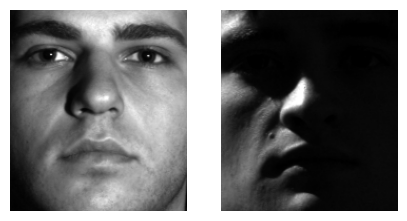



Expected = 34        Predicted = 28


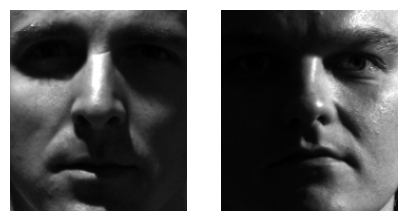



Expected = 7        Predicted = 33


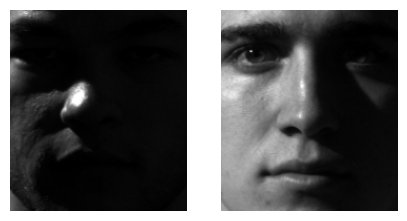



Expected = 36        Predicted = 33


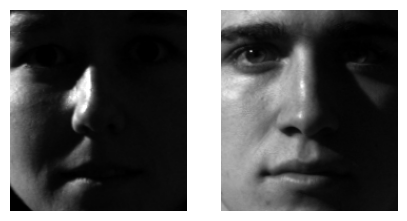



Expected = 14        Predicted = 21


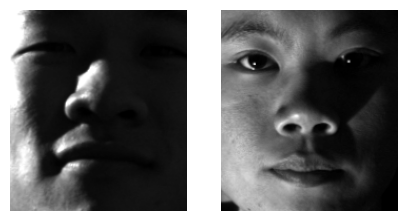



Expected = 19        Predicted = 26


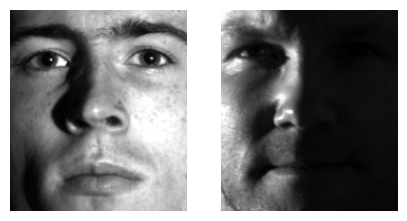



Expected = 20        Predicted = 12


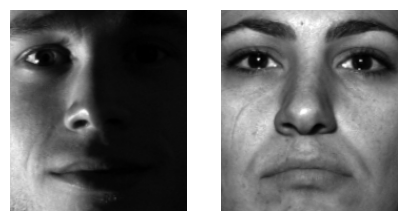



Expected = 3        Predicted = 0


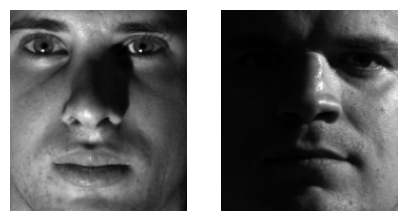



Expected = 0        Predicted = 34


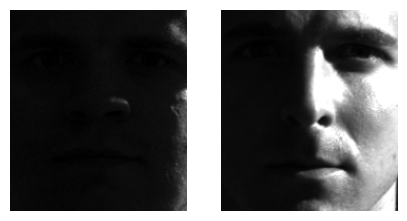



Expected = 20        Predicted = 19


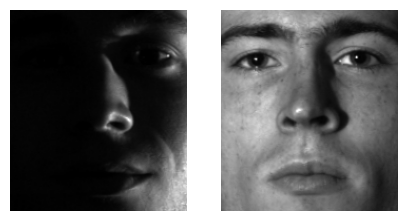



Expected = 6        Predicted = 4


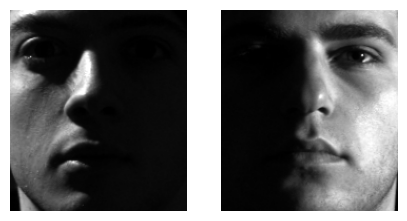



Expected = 16        Predicted = 29


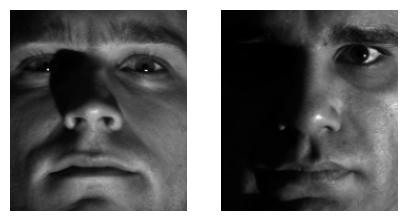



Expected = 10        Predicted = 34


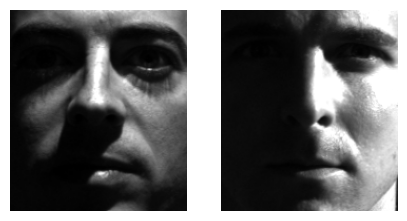



Expected = 6        Predicted = 16


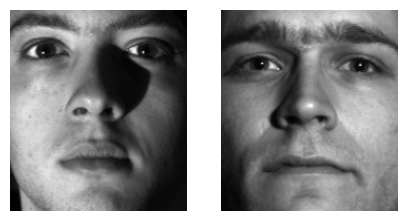



Expected = 17        Predicted = 13


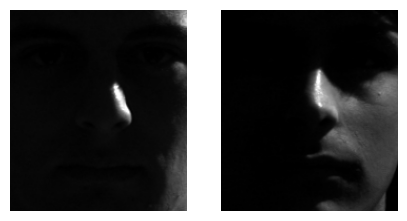



Expected = 30        Predicted = 33


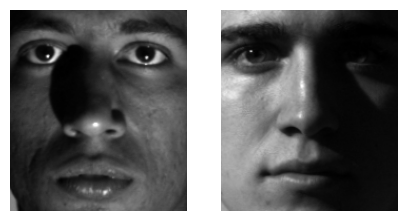



Expected = 31        Predicted = 0


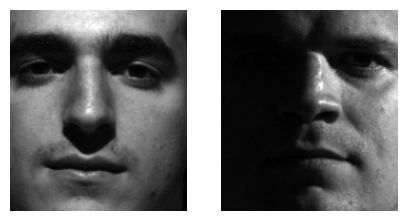



Expected = 26        Predicted = 31


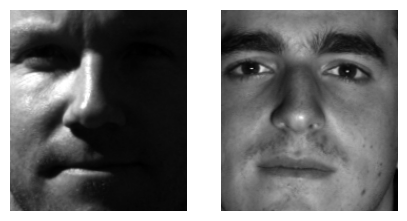



Expected = 16        Predicted = 0


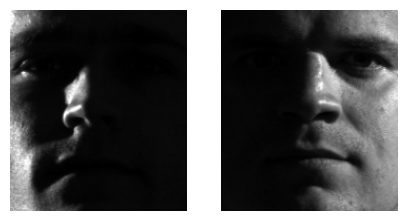



Expected = 10        Predicted = 32


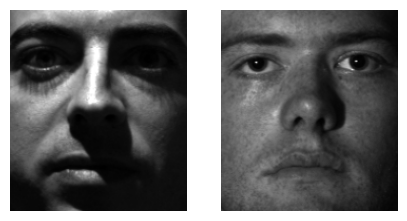



Expected = 26        Predicted = 28


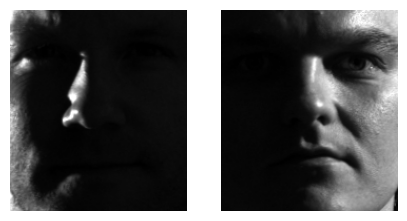



Expected = 17        Predicted = 13


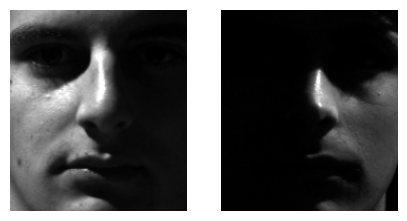

In [9]:
for i in range(len(y_test)):
    if correct[i] == 0:
        print("Expected =", y_test[i], "     ", " Predicted =", predicted[i])
        plot_guesses(X_test[i], X[predicted[i] * 64])
